# Inception model explanations

## First we need dataframes for every subject

In [92]:
import sys
sys.path.append('../')

# import os
# os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"   # see issue #152
# os.environ["CUDA_VISIBLE_DEVICES"] = "2"

import pandas as pd
import numpy as np
import utils

# DEFINE GRAPH
from importlib import reload
reload(utils)


<module 'utils' from '/home/sofia/Documents/painface-recognition/notebooks/utils.py'>

In [17]:
# Data paths
rgb_path = '../data/jpg_320_180_2fps/'
of_path = 'no'

# Hyperparameters
input_width = 320
input_height = 180
seq_length = 1
seq_stride = 1
batch_size = 1
COLOR = True
nb_labels = 2

# Data augmentation
aug_flip = 0
aug_crop = 0
aug_light = 0

subject_ids = pd.read_csv('../metadata/horse_subjects.csv')['Subject'].values
channels = 3

In [18]:
from utils import ArgsProxy
args = ArgsProxy(rgb_path, of_path, input_height, input_width,
                 seq_length, seq_stride, batch_size, nb_labels,
                 aug_flip, aug_crop, aug_light)

In [19]:
import data_handler as dathand
dh = dathand.DataHandler(path=args.data_path,
                         of_path=args.of_path,
                         clip_list_file='videos_overview_missingremoved.csv',
                         data_columns=['Pain'],  # Here one can append f. ex. 'Observer'
                         image_size=(args.input_height, args.input_width),
                         seq_length=args.seq_length,
                         seq_stride=args.seq_stride,
                         batch_size=args.batch_size,
                         color=COLOR,
                         nb_labels=args.nb_labels,
                         aug_flip=args.aug_flip,
                         aug_crop=args.aug_crop,
                         aug_light=args.aug_light)

In [20]:
import utils
subject_dfs = utils.read_or_create_subject_dfs(dh, args, subject_ids)

../data/jpg_320_180_2fps/
../data/jpg_320_180_2fps/
../data/jpg_320_180_2fps/
../data/jpg_320_180_2fps/
../data/jpg_320_180_2fps/
../data/jpg_320_180_2fps/


In [22]:
sequence_df = utils.get_sequence(args=args, subject_dfs=subject_dfs, subject=4)
y = sequence_df['Pain'].values
image_paths = sequence_df['Path'].values

In [23]:
from keras.utils import np_utils
label_onehot = np_utils.to_categorical(y, num_classes=args.nb_labels)
batch_label = label_onehot.reshape(args.batch_size, -1)
batch_img = np.concatenate(utils.read_images_and_return_list(args, image_paths), axis=1)

## Now that we have frames from all subjects, we can load the model we want to test.

In [26]:
# Choose a model to work on
best_model_path = '../models/BEST_MODEL_inception_4d_input_from_scratch_rmsprop_LSTMunits_None_CONVfilters_None_dense512_320x180jpg2fps_bs100_rmsprop_noaug_v4_t1_run4.h5'
import keras
m = keras.models.load_model(best_model_path)

In [115]:
from keras import backend as K
import tensorflow as tf
    
images = tf.placeholder(tf.float32, [batch_size, args.input_width, args.input_height, channels])
labels = tf.placeholder(tf.float32, [batch_size, 2])
model = m

print(model.layers[-1].name)
print(model.layers[-2].name)

print(type(model.get_layer('dense_2').output))
print(type(model.get_layer('dense_1')))
print('DENSE_2 aka PREDS')
print(model.get_layer('dense_2').get_config())
print('DENSE_1 aka DENSE')
print(model.get_layer('dense_1').get_config())

print('mixed 9')
print(type(model.get_layer('mixed9_0').output))


logits = model(images)

# model = utils.InceptionNetwork(images, from_scratch=0, path=best_model_path)
sess = K.get_session()  # Grab the Keras session where the weights are initialized.

target_conv_layer = model.get_layer('mixed9_1')([images, images, images, images])

# cost = (-1) * tf.reduce_sum(tf.multiply(labels, tf.log(model.get_layer('dense_2').output)), axis=1)

cost = (-1) * tf.reduce_sum(tf.multiply(labels, tf.log(logits)), axis=1)
    
y_c = tf.reduce_sum(tf.multiply(logits, labels), axis=1)

    
target_conv_layer_grad = tf.gradients(y_c, target_conv_layer)[0]
    
gb_grad = tf.gradients(cost, images)[0]  # Guided backpropagation back to input layer


dense_2
dense_1
<class 'tensorflow.python.framework.ops.Tensor'>
<class 'keras.layers.core.Dense'>
DENSE_2 aka PREDS
{'name': 'dense_2', 'trainable': True, 'units': 2, 'activation': 'sigmoid', 'use_bias': True, 'kernel_initializer': {'class_name': 'VarianceScaling', 'config': {'scale': 1.0, 'mode': 'fan_avg', 'distribution': 'uniform', 'seed': None}}, 'bias_initializer': {'class_name': 'Zeros', 'config': {}}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}
DENSE_1 aka DENSE
{'name': 'dense_1', 'trainable': True, 'units': 512, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'class_name': 'VarianceScaling', 'config': {'scale': 1.0, 'mode': 'fan_avg', 'distribution': 'uniform', 'seed': None}}, 'bias_initializer': {'class_name': 'Zeros', 'config': {}}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}
mi

In [130]:
def run_on_one_sequence(sess, model, batch_img):
    with sess.as_default():
        prob = sess.run(logits,
                        feed_dict={images: batch_img,
                                   K.learning_phase(): 0})

        print(prob)

        gb_grad_value = sess.run(gb_grad,
                                 feed_dict={images: batch_img,
                                            labels: batch_label,
                                            K.learning_phase(): 0})
        
        target_conv_layer_value = sess.run(target_conv_layer,
                                         feed_dict={images: batch_img,
                                                    labels: batch_label,
                                                    K.learning_phase(): 0})
        
        target_conv_layer_grad_value = sess.run(target_conv_layer_grad,
                                 feed_dict={images: batch_img,
                                            labels: batch_label,
                                            K.learning_phase(): 0})
        
#         gb_grad_value, target_conv_layer_value, target_conv_layer_grad_value = sess.run([gb_grad, target_conv_layer, target_conv_layer_grad],
#                       feed_dict={images: batch_img,
#                                  labels: batch_label,
#                                  K.learning_phase(): 0})
        
#         target_conv_layer_value = np.reshape(target_conv_layer_value,
#                                      (1, 10, 16, 16, 32))
        
#         target_conv_layer_grad_value = np.reshape(target_conv_layer_grad_value,
#                                      (1, 10, 16, 16, 32))


#         visualize_overlays(batch_img, target_conv_layer_value,
#                            target_conv_layer_grad_value)

        for i in range(seq_length):
            print(prob[0,i])
        print(batch_label)

In [85]:
for i in range(20):
    print(model.layers[i].name)

input_2
conv2d_1
batch_normalization_1
activation_1
conv2d_2
batch_normalization_2
activation_2
conv2d_3
batch_normalization_3
activation_3
max_pooling2d_1
conv2d_4
batch_normalization_4
activation_4
conv2d_5
batch_normalization_5
activation_5
max_pooling2d_2
conv2d_9
batch_normalization_9


# Inception predictions for subject 0

In [131]:
batch_img, batch_label = utils.data_for_one_random_sequence(args, subject_dfs, subject=1)
# print(batch_img.shape)
# print(type(batch_img))
batch_img = np.array(batch_img, dtype=np.float32)
# print(type(batch_img))
# print(batch_img)

batch_label = np.array(batch_label, dtype=np.uint8)
# print(type(batch_label))
# print(batch_label)
run_on_one_sequence(sess, model, batch_img)

[[ 1.  0.]]


TypeError: Fetch argument None has invalid type <class 'NoneType'>

[[[ 0.51420838  0.31817237]
  [ 0.77988219  0.13004306]
  [ 0.95136052  0.05402187]
  [ 0.97584337  0.02355918]
  [ 0.97799563  0.01227138]
  [ 0.95234174  0.00783889]
  [ 0.88624084  0.00769422]
  [ 0.78049189  0.00831641]
  [ 0.70834178  0.00855848]
  [ 0.65385073  0.00903009]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


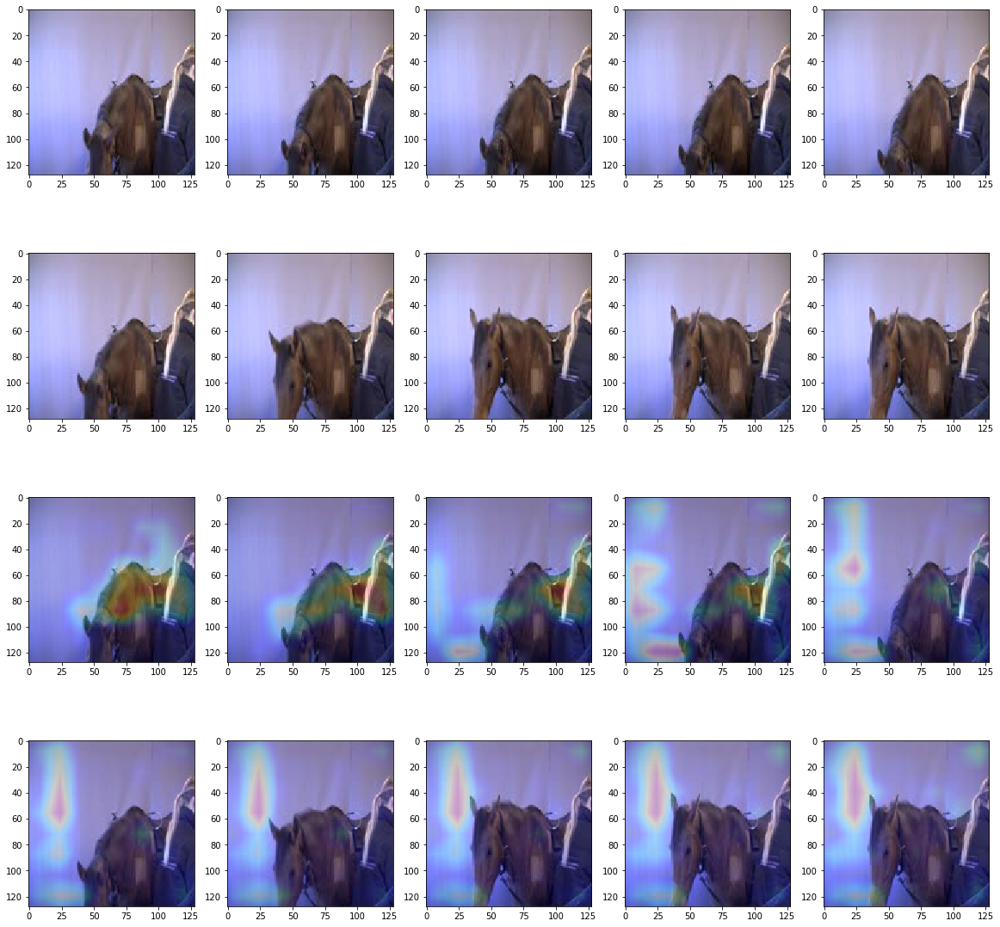

[ 0.51420838  0.31817237]
[ 0.77988219  0.13004306]
[ 0.95136052  0.05402187]
[ 0.97584337  0.02355918]
[ 0.97799563  0.01227138]
[ 0.95234174  0.00783889]
[ 0.88624084  0.00769422]
[ 0.78049189  0.00831641]
[ 0.70834178  0.00855848]
[ 0.65385073  0.00903009]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [58]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.63918465  0.36880109]
  [ 0.62752187  0.42204234]
  [ 0.38939589  0.38959765]
  [ 0.20165412  0.31566891]
  [ 0.14496589  0.30577046]
  [ 0.1758846   0.3364059 ]
  [ 0.15818033  0.36673358]
  [ 0.16424668  0.42315778]
  [ 0.14600074  0.48408902]
  [ 0.11328818  0.58477604]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


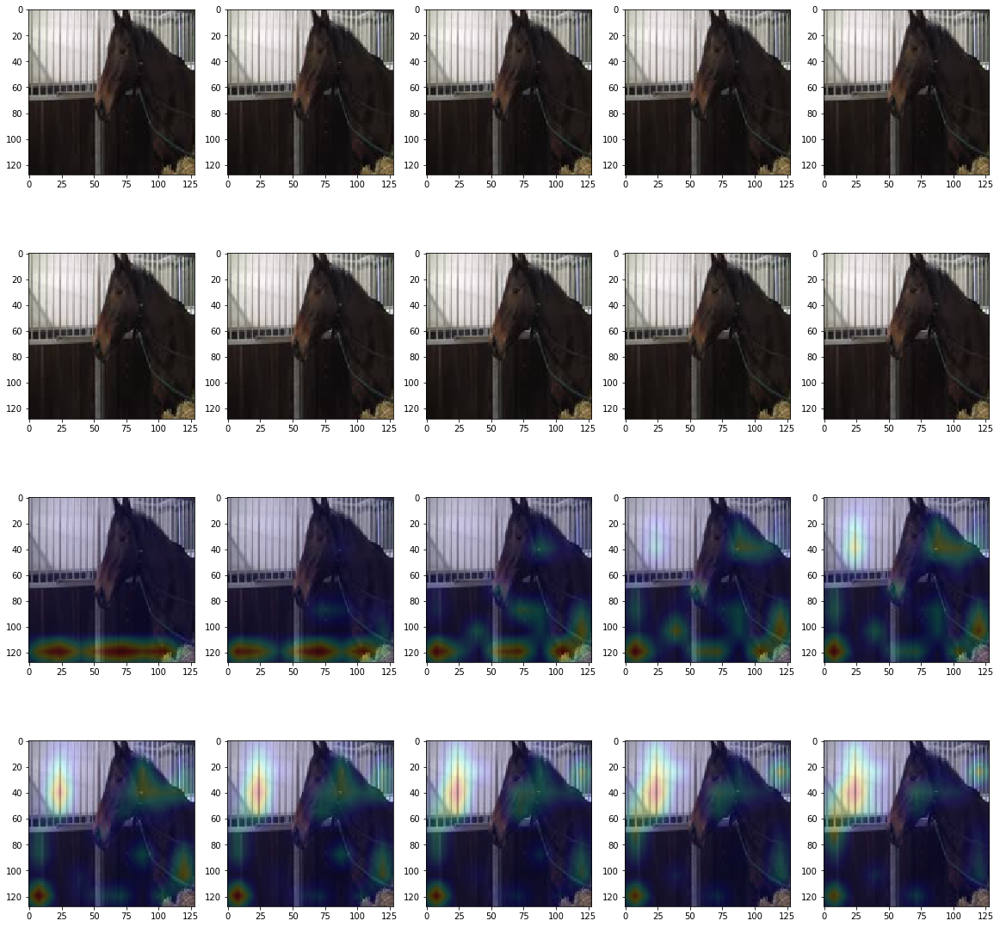

[ 0.63918465  0.36880109]
[ 0.62752187  0.42204234]
[ 0.38939589  0.38959765]
[ 0.20165412  0.31566891]
[ 0.14496589  0.30577046]
[ 0.1758846  0.3364059]
[ 0.15818033  0.36673358]
[ 0.16424668  0.42315778]
[ 0.14600074  0.48408902]
[ 0.11328818  0.58477604]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [63]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[  5.23925185e-01   4.85978603e-01]
  [  1.84781879e-01   8.18626583e-01]
  [  9.52241290e-03   9.90191579e-01]
  [  6.36060257e-04   9.99467909e-01]
  [  1.53250090e-04   9.99868751e-01]
  [  8.80435327e-05   9.99920368e-01]
  [  9.81433841e-05   9.99943733e-01]
  [  2.83492001e-04   9.99931455e-01]
  [  8.07352830e-04   9.99904156e-01]
  [  2.08036671e-03   9.99886632e-01]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


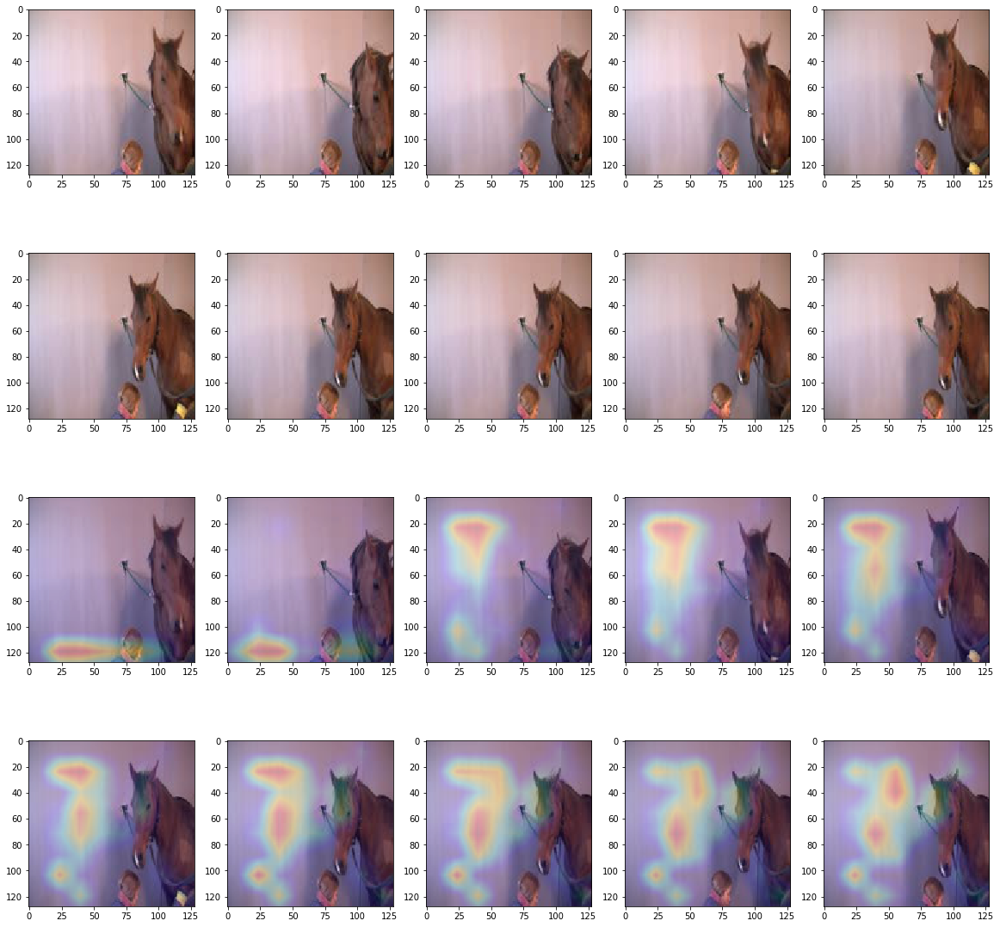

[ 0.52392519  0.4859786 ]
[ 0.18478188  0.81862658]
[ 0.00952241  0.99019158]
[  6.36060257e-04   9.99467909e-01]
[  1.53250090e-04   9.99868751e-01]
[  8.80435327e-05   9.99920368e-01]
[  9.81433841e-05   9.99943733e-01]
[  2.83492001e-04   9.99931455e-01]
[  8.07352830e-04   9.99904156e-01]
[ 0.00208037  0.99988663]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [64]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.72208071  0.32329828]
  [ 0.92855966  0.12240092]
  [ 0.98325723  0.02157678]
  [ 0.99398828  0.00530799]
  [ 0.99584609  0.00307372]
  [ 0.99682885  0.00317291]
  [ 0.997531    0.00367681]
  [ 0.99791747  0.00370604]
  [ 0.99782133  0.00378615]
  [ 0.99791902  0.00533568]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


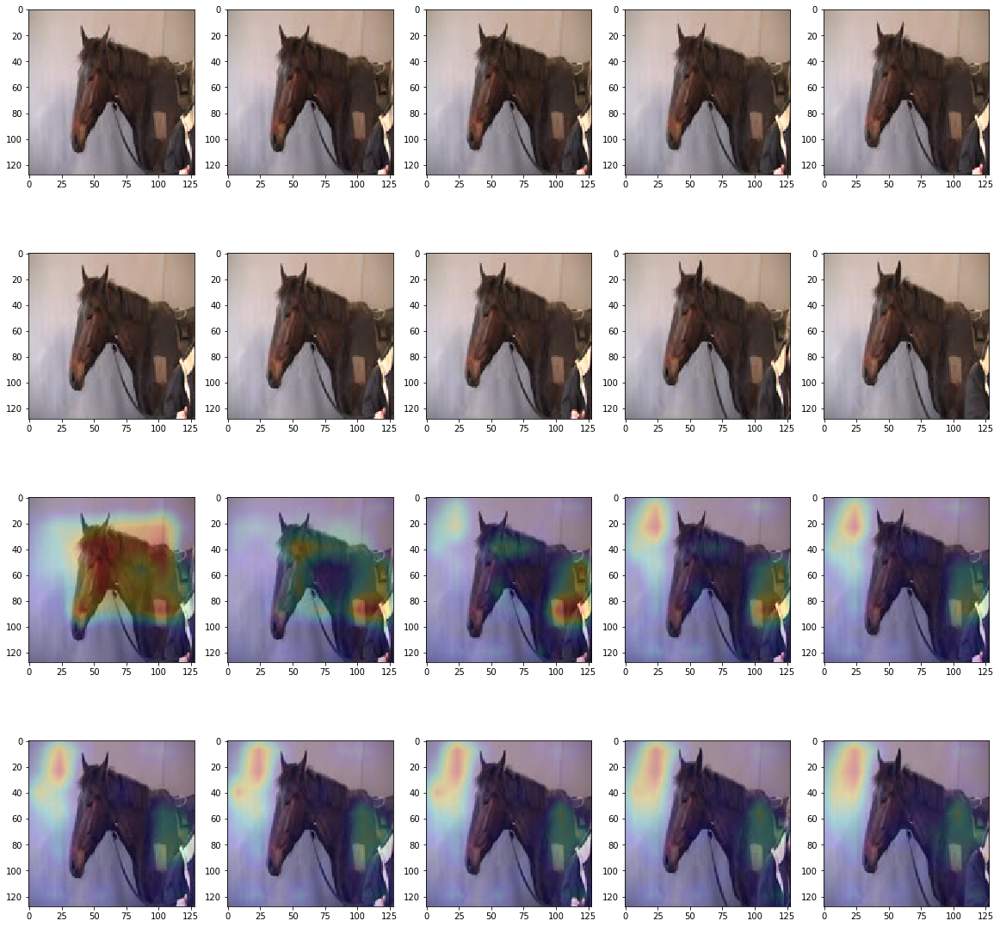

[ 0.72208071  0.32329828]
[ 0.92855966  0.12240092]
[ 0.98325723  0.02157678]
[ 0.99398828  0.00530799]
[ 0.99584609  0.00307372]
[ 0.99682885  0.00317291]
[ 0.997531    0.00367681]
[ 0.99791747  0.00370604]
[ 0.99782133  0.00378615]
[ 0.99791902  0.00533568]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [65]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[  7.45624423e-01   2.88610399e-01]
  [  9.51340973e-01   7.21511394e-02]
  [  9.90119934e-01   1.21441903e-02]
  [  9.97860253e-01   1.48350990e-03]
  [  9.99346077e-01   3.20116931e-04]
  [  9.99638557e-01   1.37702285e-04]
  [  9.99684572e-01   1.29232430e-04]
  [  9.99637008e-01   2.18259127e-04]
  [  9.99495983e-01   4.16846626e-04]
  [  9.99232888e-01   7.96555774e-04]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


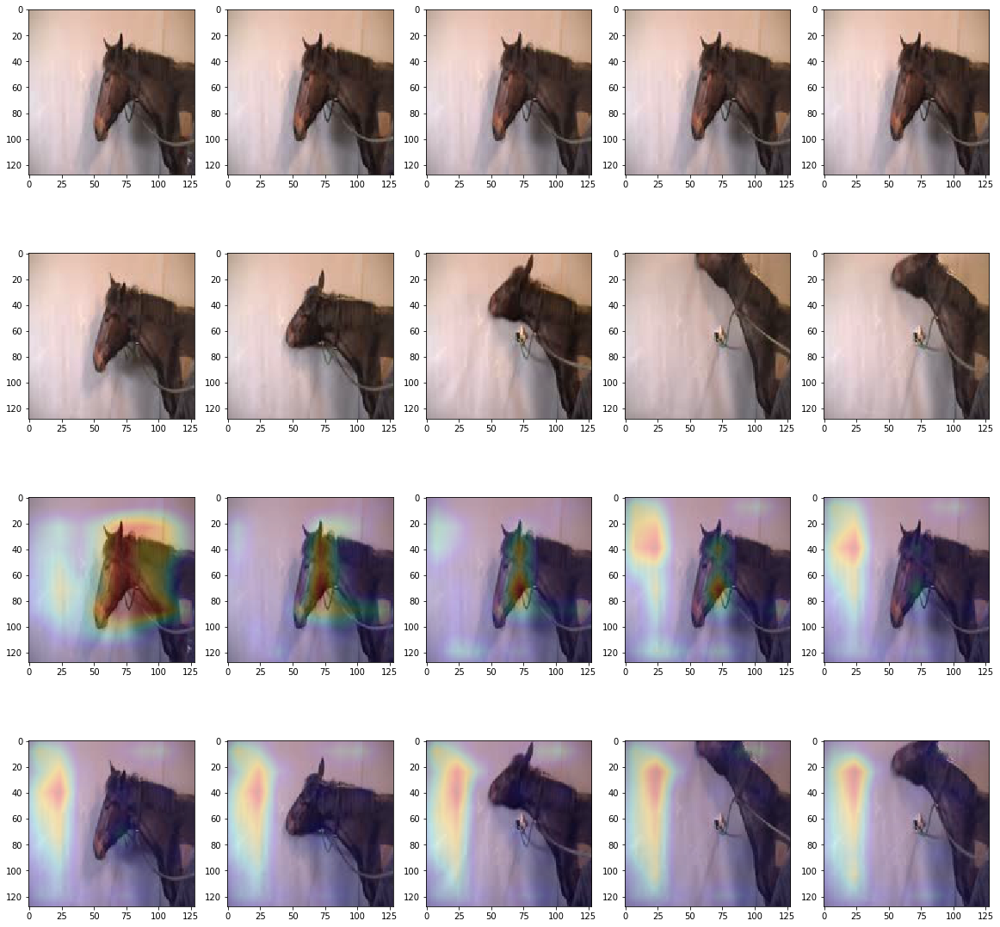

[ 0.74562442  0.2886104 ]
[ 0.95134097  0.07215114]
[ 0.99011993  0.01214419]
[ 0.99786025  0.00148351]
[  9.99346077e-01   3.20116931e-04]
[  9.99638557e-01   1.37702285e-04]
[  9.99684572e-01   1.29232430e-04]
[  9.99637008e-01   2.18259127e-04]
[  9.99495983e-01   4.16846626e-04]
[  9.99232888e-01   7.96555774e-04]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [66]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[  5.03179133e-01   4.02220577e-01]
  [  1.27028584e-01   7.40166008e-01]
  [  3.34696379e-03   9.40347612e-01]
  [  2.98039988e-04   9.77196693e-01]
  [  1.53464905e-04   9.84504938e-01]
  [  1.68160739e-04   9.89209116e-01]
  [  2.92009703e-04   9.91140962e-01]
  [  6.43214909e-04   9.93106782e-01]
  [  1.32280192e-03   9.95034575e-01]
  [  1.65854197e-03   9.95644212e-01]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


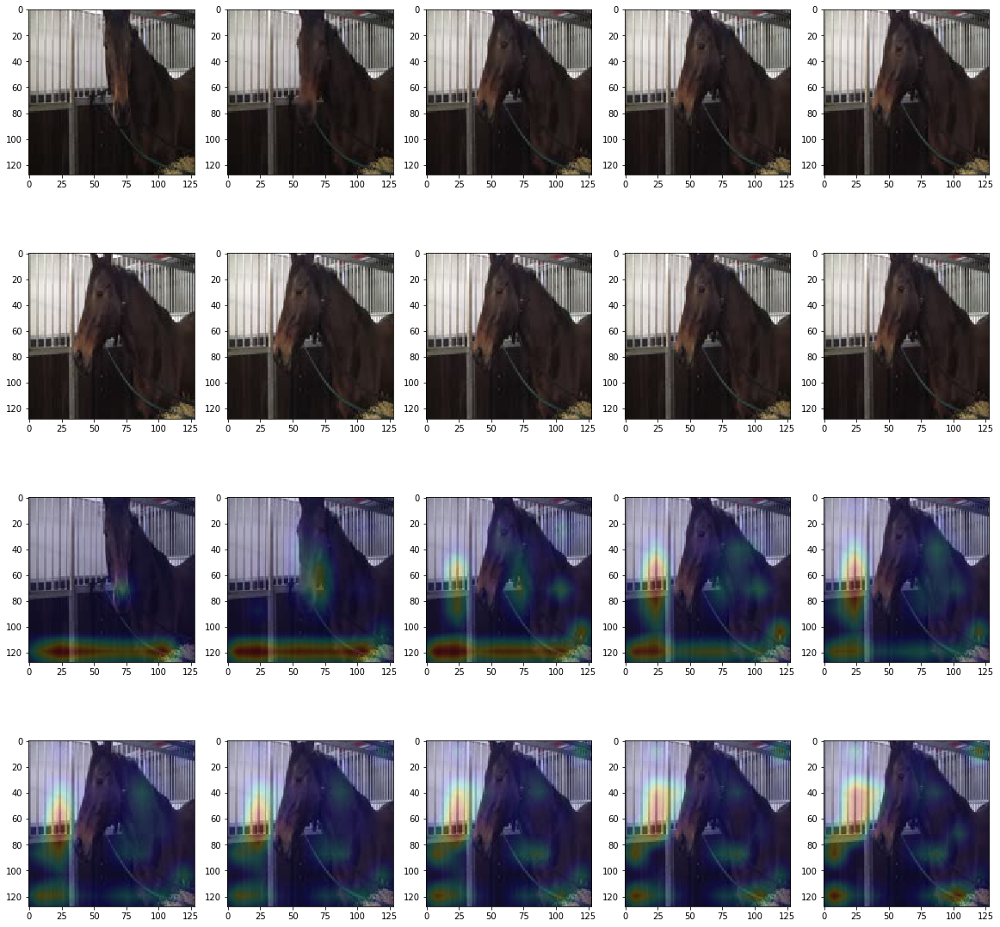

[ 0.50317913  0.40222058]
[ 0.12702858  0.74016601]
[ 0.00334696  0.94034761]
[  2.98039988e-04   9.77196693e-01]
[  1.53464905e-04   9.84504938e-01]
[  1.68160739e-04   9.89209116e-01]
[  2.92009703e-04   9.91140962e-01]
[  6.43214909e-04   9.93106782e-01]
[ 0.0013228   0.99503458]
[ 0.00165854  0.99564421]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [67]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.55063039  0.40671661]
  [ 0.27064693  0.70321125]
  [ 0.06561149  0.93337148]
  [ 0.02086315  0.97824109]
  [ 0.01232643  0.98497748]
  [ 0.00965665  0.98666626]
  [ 0.00606266  0.98349631]
  [ 0.00400396  0.97611976]
  [ 0.0034023   0.95524073]
  [ 0.00380073  0.92523676]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


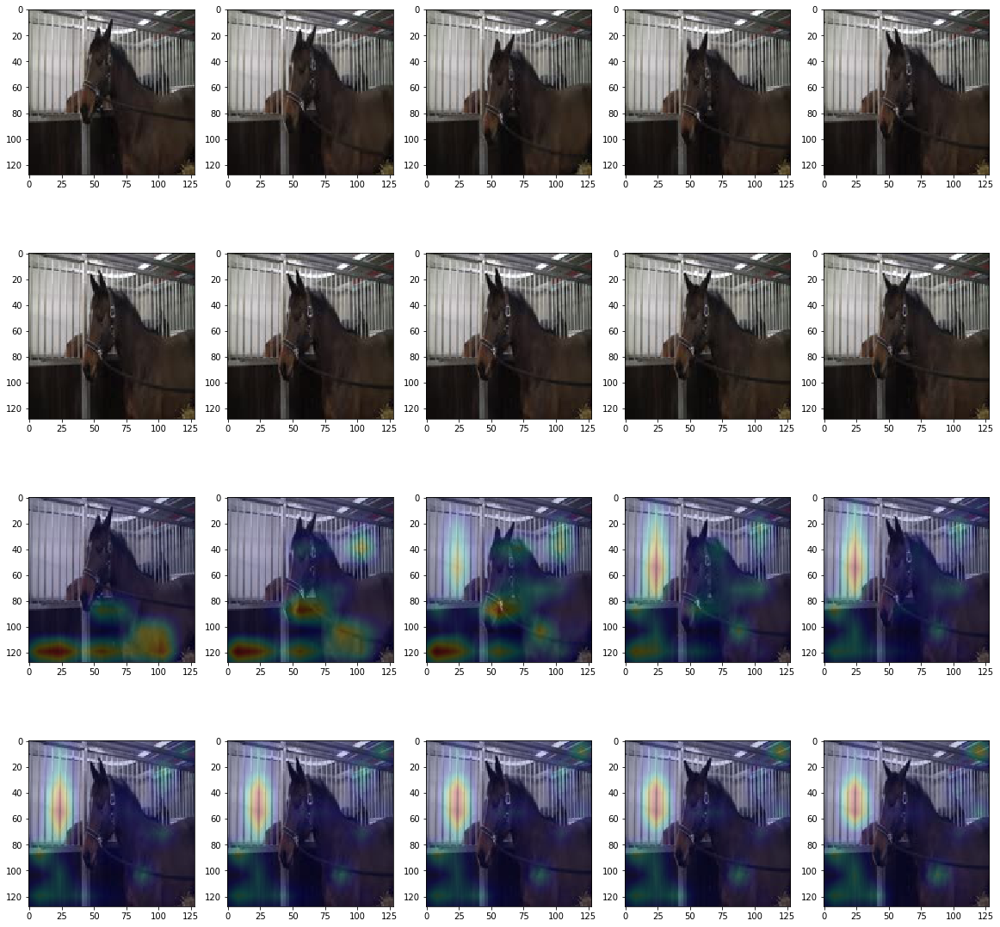

[ 0.55063039  0.40671661]
[ 0.27064693  0.70321125]
[ 0.06561149  0.93337148]
[ 0.02086315  0.97824109]
[ 0.01232643  0.98497748]
[ 0.00965665  0.98666626]
[ 0.00606266  0.98349631]
[ 0.00400396  0.97611976]
[ 0.0034023   0.95524073]
[ 0.00380073  0.92523676]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [69]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.55289596  0.46244088]
  [ 0.30118135  0.55061138]
  [ 0.07140448  0.54680479]
  [ 0.02831373  0.59400278]
  [ 0.02286668  0.71053499]
  [ 0.02364425  0.80233437]
  [ 0.02581444  0.8348068 ]
  [ 0.02591525  0.8624174 ]
  [ 0.03101055  0.83029974]
  [ 0.0375652   0.79898185]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


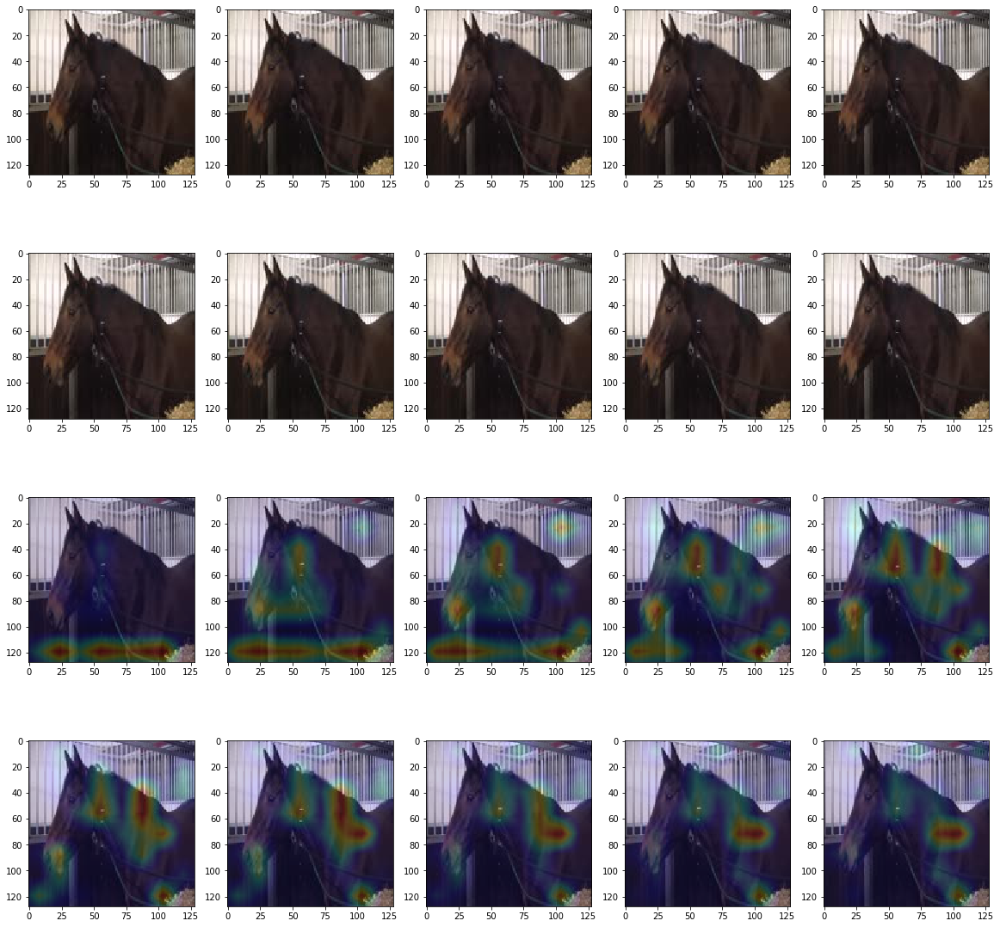

[ 0.55289596  0.46244088]
[ 0.30118135  0.55061138]
[ 0.07140448  0.54680479]
[ 0.02831373  0.59400278]
[ 0.02286668  0.71053499]
[ 0.02364425  0.80233437]
[ 0.02581444  0.8348068 ]
[ 0.02591525  0.8624174 ]
[ 0.03101055  0.83029974]
[ 0.0375652   0.79898185]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [70]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[  4.81970161e-01   5.04658520e-01]
  [  6.55382946e-02   9.00938749e-01]
  [  1.76236453e-03   9.87163782e-01]
  [  1.56362978e-04   9.95945990e-01]
  [  4.66045713e-05   9.97467518e-01]
  [  2.49214154e-05   9.97578919e-01]
  [  2.50777157e-05   9.97407377e-01]
  [  2.30353999e-05   9.97011900e-01]
  [  4.03670456e-05   9.95843947e-01]
  [  8.54829268e-05   9.94746864e-01]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


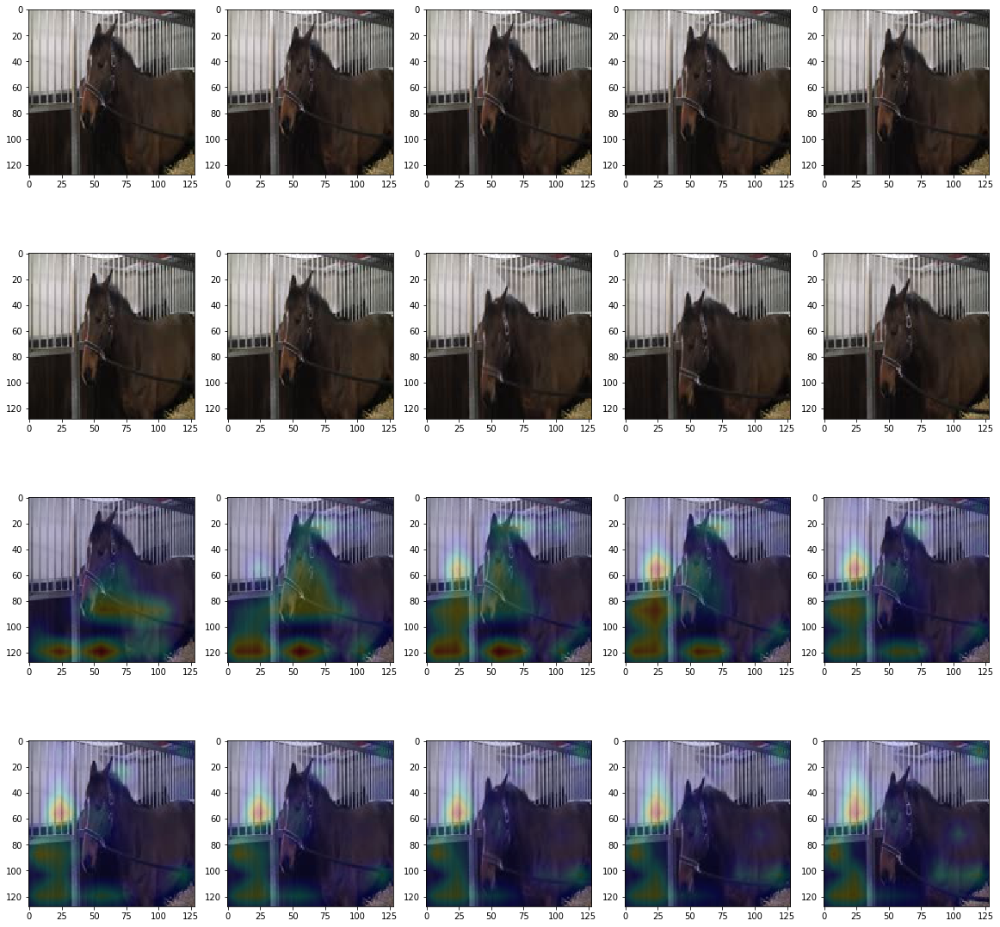

[ 0.48197016  0.50465852]
[ 0.06553829  0.90093875]
[ 0.00176236  0.98716378]
[  1.56362978e-04   9.95945990e-01]
[  4.66045713e-05   9.97467518e-01]
[  2.49214154e-05   9.97578919e-01]
[  2.50777157e-05   9.97407377e-01]
[  2.30353999e-05   9.97011900e-01]
[  4.03670456e-05   9.95843947e-01]
[  8.54829268e-05   9.94746864e-01]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [71]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.62952167  0.35831183]
  [ 0.76101774  0.27372596]
  [ 0.75922465  0.1718383 ]
  [ 0.7689448   0.12636165]
  [ 0.73855156  0.15997924]
  [ 0.67166549  0.23287794]
  [ 0.62815779  0.26412943]
  [ 0.63431883  0.28758299]
  [ 0.62133062  0.29232293]
  [ 0.57229918  0.36441255]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


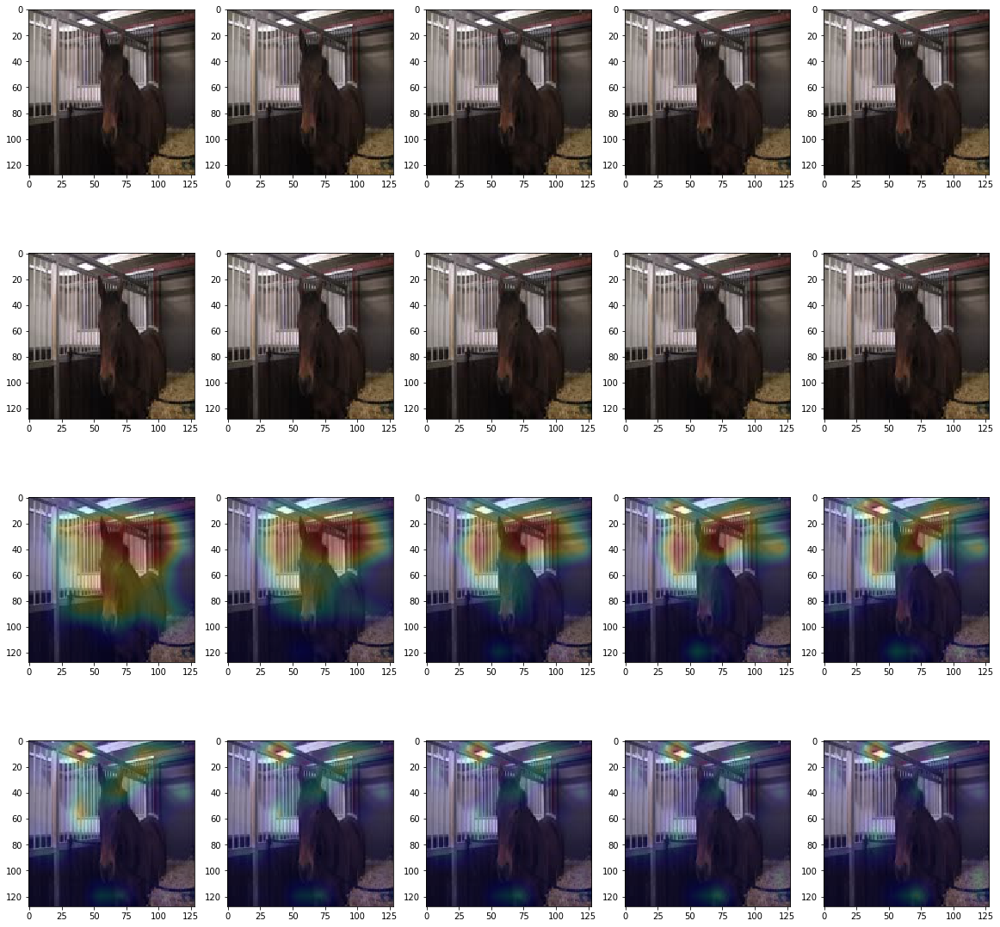

[ 0.62952167  0.35831183]
[ 0.76101774  0.27372596]
[ 0.75922465  0.1718383 ]
[ 0.7689448   0.12636165]
[ 0.73855156  0.15997924]
[ 0.67166549  0.23287794]
[ 0.62815779  0.26412943]
[ 0.63431883  0.28758299]
[ 0.62133062  0.29232293]
[ 0.57229918  0.36441255]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [72]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[  4.78239506e-01   5.10007858e-01]
  [  1.68269783e-01   8.68418574e-01]
  [  6.77967770e-03   9.94203985e-01]
  [  4.17052099e-04   9.99511480e-01]
  [  6.07163893e-05   9.99870777e-01]
  [  3.26164009e-05   9.99933481e-01]
  [  3.12213197e-05   9.99962330e-01]
  [  3.98348457e-05   9.99962330e-01]
  [  4.81398129e-05   9.99940515e-01]
  [  8.42803856e-05   9.99891043e-01]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


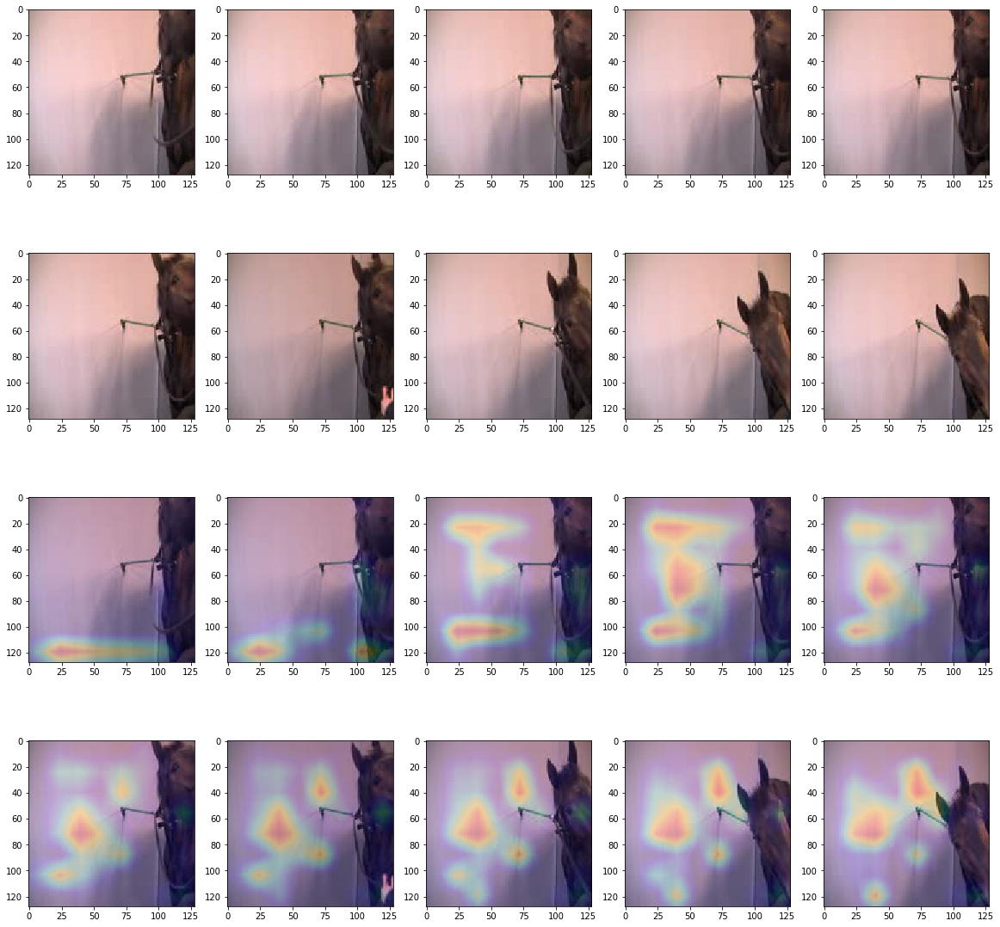

[ 0.47823951  0.51000786]
[ 0.16826978  0.86841857]
[ 0.00677968  0.99420398]
[  4.17052099e-04   9.99511480e-01]
[  6.07163893e-05   9.99870777e-01]
[  3.26164009e-05   9.99933481e-01]
[  3.12213197e-05   9.99962330e-01]
[  3.98348457e-05   9.99962330e-01]
[  4.81398129e-05   9.99940515e-01]
[  8.42803856e-05   9.99891043e-01]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [73]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[  6.51253760e-01   3.47462922e-01]
  [  8.63812804e-01   1.16358355e-01]
  [  9.83370423e-01   9.17298067e-03]
  [  9.98220384e-01   5.84591413e-04]
  [  9.99790370e-01   7.34922505e-05]
  [  9.99950767e-01   2.09706541e-05]
  [  9.99974847e-01   1.37847001e-05]
  [  9.99963880e-01   1.45269842e-05]
  [  9.99918461e-01   1.69036393e-05]
  [  9.99844432e-01   2.24179621e-05]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


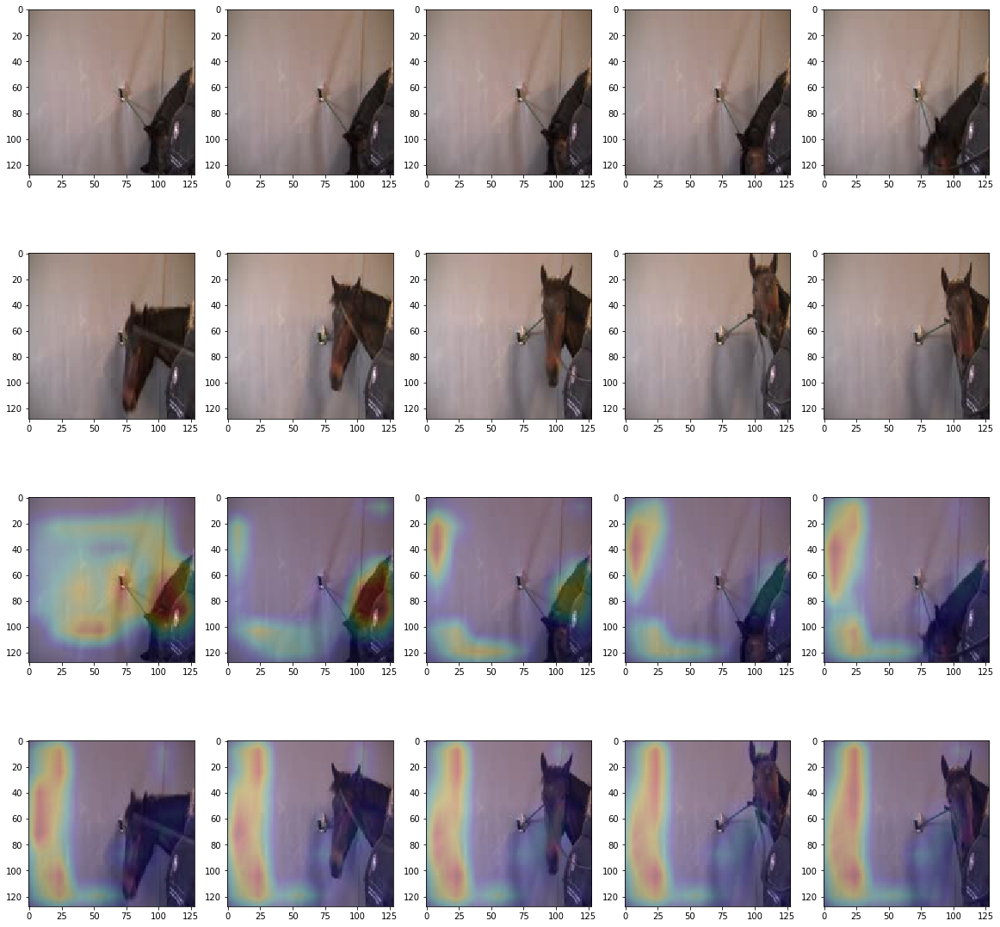

[ 0.65125376  0.34746292]
[ 0.8638128   0.11635835]
[ 0.98337042  0.00917298]
[  9.98220384e-01   5.84591413e-04]
[  9.99790370e-01   7.34922505e-05]
[  9.99950767e-01   2.09706541e-05]
[  9.99974847e-01   1.37847001e-05]
[  9.99963880e-01   1.45269842e-05]
[  9.99918461e-01   1.69036393e-05]
[  9.99844432e-01   2.24179621e-05]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [75]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.71658057  0.31081429]
  [ 0.91485429  0.15861447]
  [ 0.93743104  0.06850053]
  [ 0.94407004  0.04645471]
  [ 0.92907304  0.05047373]
  [ 0.92458612  0.04985973]
  [ 0.91291434  0.04613488]
  [ 0.93429834  0.03367021]
  [ 0.94939882  0.02819576]
  [ 0.95967245  0.02856774]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


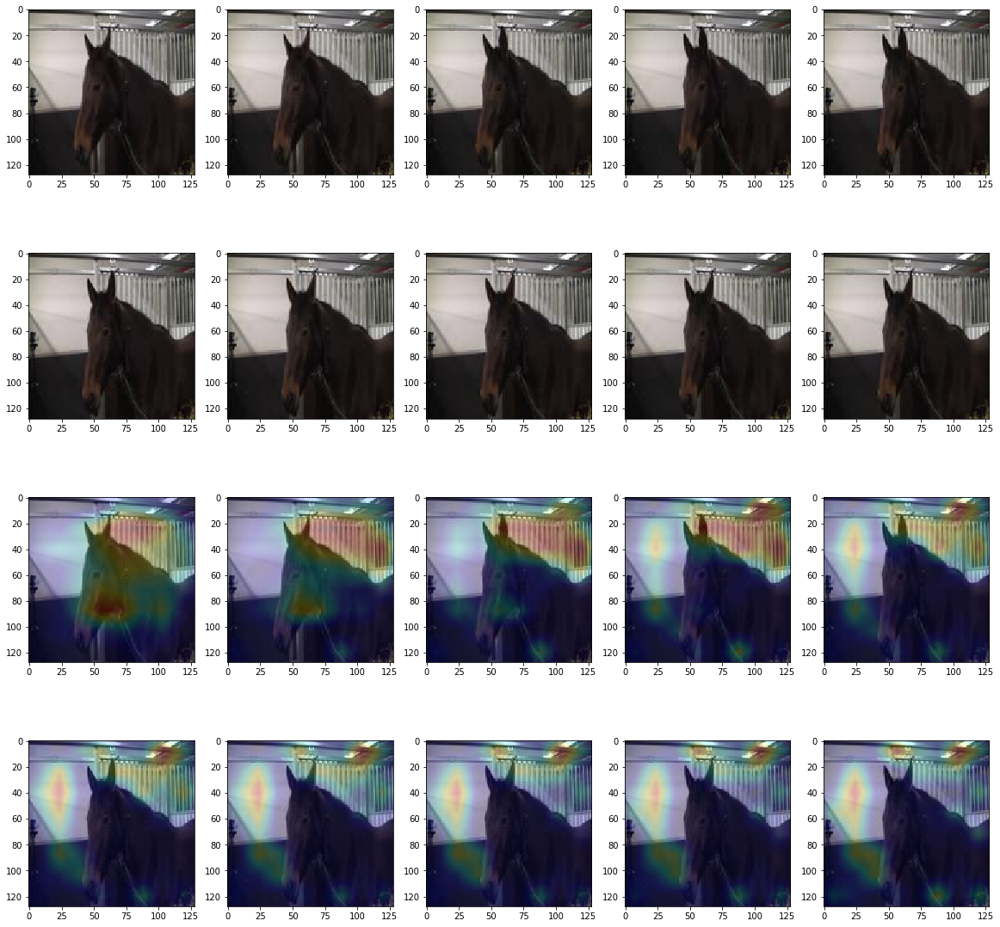

[ 0.71658057  0.31081429]
[ 0.91485429  0.15861447]
[ 0.93743104  0.06850053]
[ 0.94407004  0.04645471]
[ 0.92907304  0.05047373]
[ 0.92458612  0.04985973]
[ 0.91291434  0.04613488]
[ 0.93429834  0.03367021]
[ 0.94939882  0.02819576]
[ 0.95967245  0.02856774]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [77]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[  7.62385726e-01   2.17799231e-01]
  [  9.81090248e-01   2.16065254e-02]
  [  9.99070585e-01   1.49432290e-03]
  [  9.99914765e-01   3.36066703e-04]
  [  9.99975562e-01   2.13851657e-04]
  [  9.99979973e-01   1.68819271e-04]
  [  9.99974370e-01   1.76498754e-04]
  [  9.99938607e-01   3.02091677e-04]
  [  9.99791682e-01   7.42833072e-04]
  [  9.99500394e-01   1.14433060e-03]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


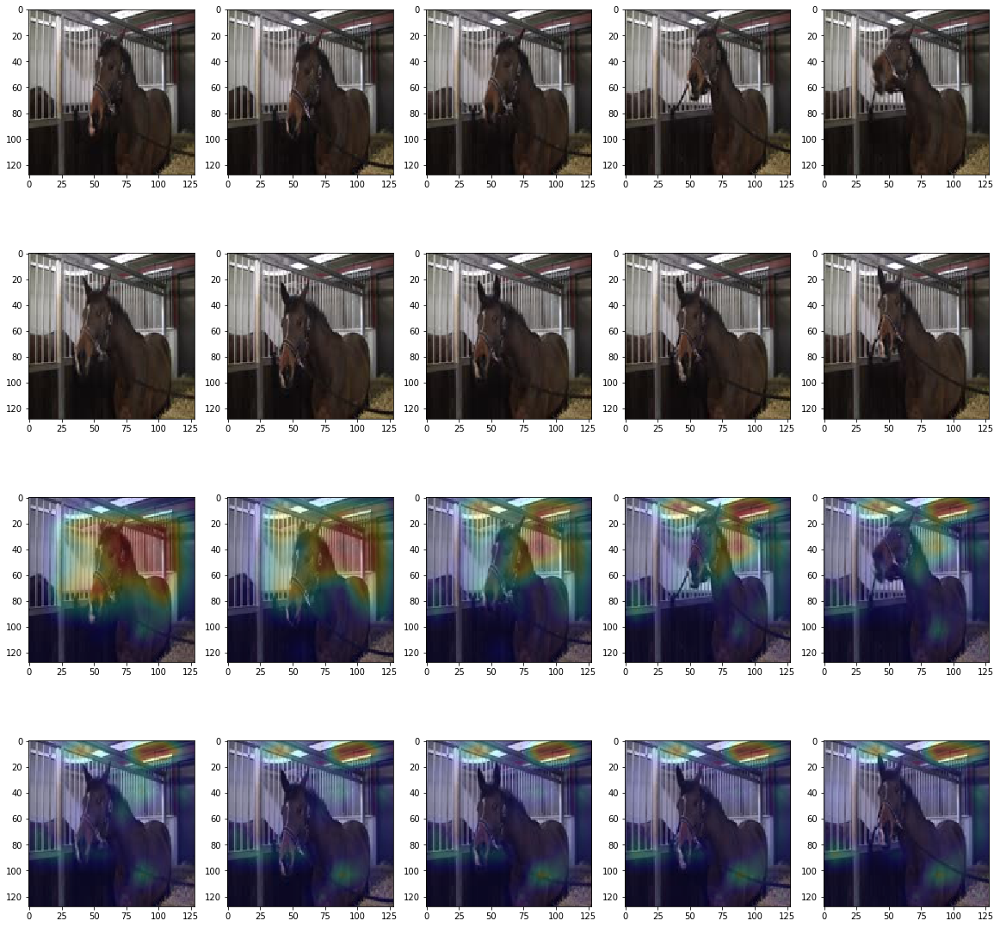

[ 0.76238573  0.21779923]
[ 0.98109025  0.02160653]
[ 0.99907058  0.00149432]
[  9.99914765e-01   3.36066703e-04]
[  9.99975562e-01   2.13851657e-04]
[  9.99979973e-01   1.68819271e-04]
[  9.99974370e-01   1.76498754e-04]
[  9.99938607e-01   3.02091677e-04]
[  9.99791682e-01   7.42833072e-04]
[ 0.99950039  0.00114433]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [78]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[  6.02284849e-01   3.60364258e-01]
  [  8.51755977e-01   1.16198920e-01]
  [  9.82567251e-01   7.01520219e-03]
  [  9.96340513e-01   7.44898338e-04]
  [  9.98077035e-01   2.41715126e-04]
  [  9.98931229e-01   1.96670167e-04]
  [  9.99103606e-01   2.53150589e-04]
  [  9.99060929e-01   3.46430927e-04]
  [  9.99128401e-01   6.49341324e-04]
  [  9.98867273e-01   1.30580063e-03]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


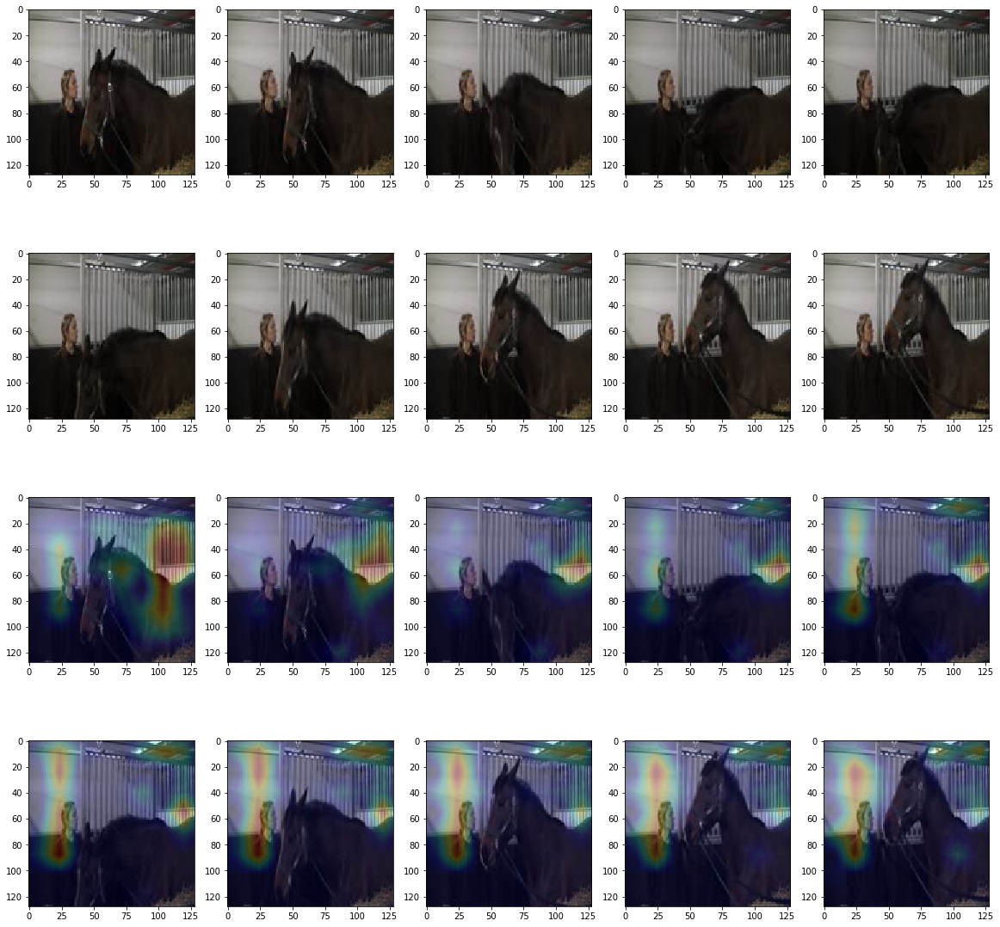

[ 0.60228485  0.36036426]
[ 0.85175598  0.11619892]
[ 0.98256725  0.0070152 ]
[  9.96340513e-01   7.44898338e-04]
[  9.98077035e-01   2.41715126e-04]
[  9.98931229e-01   1.96670167e-04]
[  9.99103606e-01   2.53150589e-04]
[  9.99060929e-01   3.46430927e-04]
[  9.99128401e-01   6.49341324e-04]
[ 0.99886727  0.0013058 ]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [79]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[  7.07622468e-01   2.78256744e-01]
  [  9.73557234e-01   4.77616638e-02]
  [  9.99090552e-01   3.66252870e-03]
  [  9.99879122e-01   5.94850280e-04]
  [  9.99924064e-01   1.88596299e-04]
  [  9.99905467e-01   2.49144854e-04]
  [  9.99869466e-01   5.05107397e-04]
  [  9.99784887e-01   1.86549767e-03]
  [  9.99660850e-01   4.27523395e-03]
  [  9.99271095e-01   7.24230567e-03]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


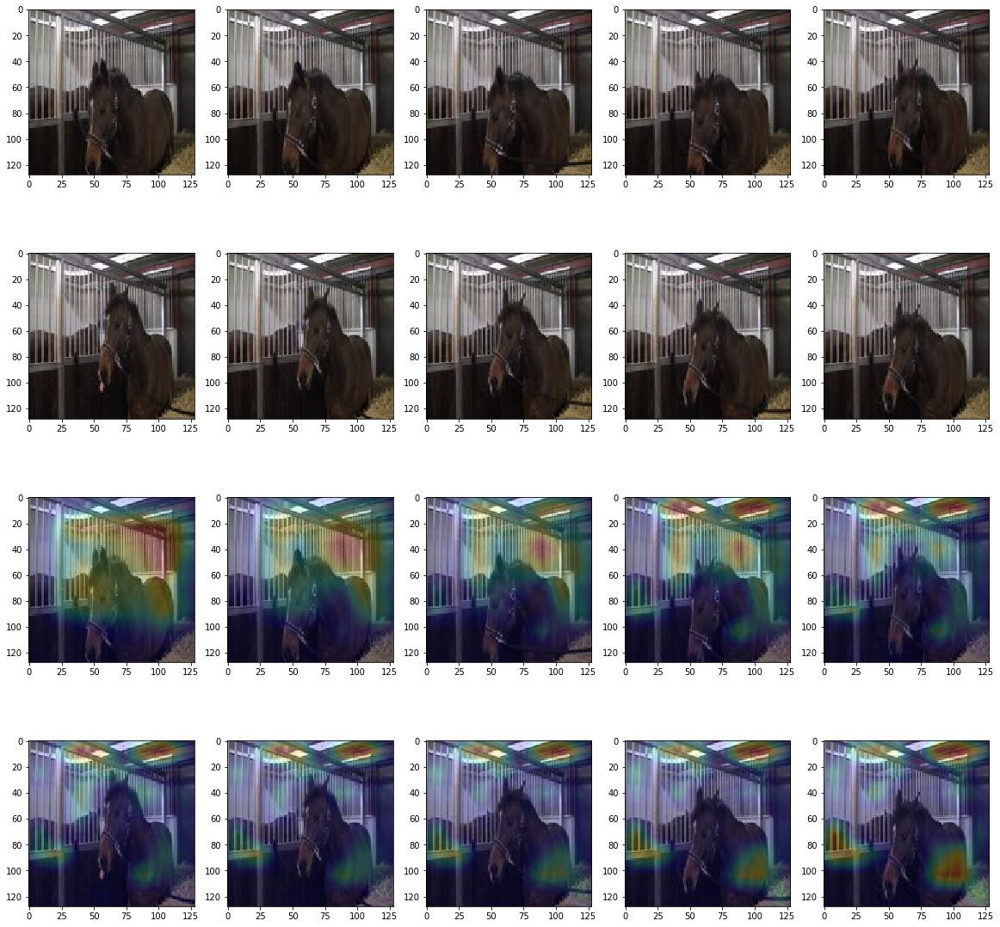

[ 0.70762247  0.27825674]
[ 0.97355723  0.04776166]
[ 0.99909055  0.00366253]
[  9.99879122e-01   5.94850280e-04]
[  9.99924064e-01   1.88596299e-04]
[  9.99905467e-01   2.49144854e-04]
[  9.99869466e-01   5.05107397e-04]
[ 0.99978489  0.0018655 ]
[ 0.99966085  0.00427523]
[ 0.99927109  0.00724231]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [81]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[  5.88644564e-01   4.02481645e-01]
  [  5.25749564e-01   4.56133068e-01]
  [  1.32418483e-01   6.69428170e-01]
  [  2.77371965e-02   8.34826171e-01]
  [  6.96720928e-03   9.14389253e-01]
  [  1.50584185e-03   9.60366488e-01]
  [  5.80385386e-04   9.75204289e-01]
  [  3.97928117e-04   9.86518681e-01]
  [  5.11487015e-04   9.86478508e-01]
  [  6.89135224e-04   9.86782014e-01]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


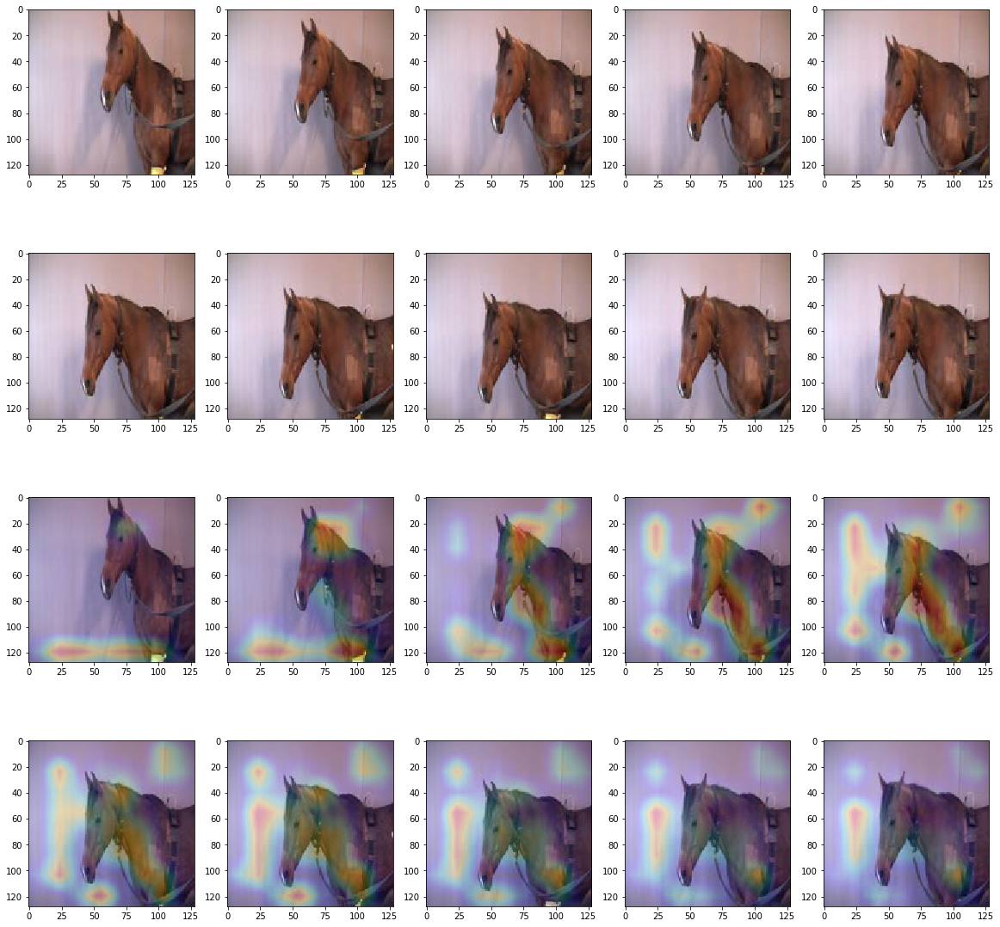

[ 0.58864456  0.40248165]
[ 0.52574956  0.45613307]
[ 0.13241848  0.66942817]
[ 0.0277372   0.83482617]
[ 0.00696721  0.91438925]
[ 0.00150584  0.96036649]
[  5.80385386e-04   9.75204289e-01]
[  3.97928117e-04   9.86518681e-01]
[  5.11487015e-04   9.86478508e-01]
[  6.89135224e-04   9.86782014e-01]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [82]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[  6.44045055e-01   3.54451925e-01]
  [  8.39811206e-01   1.00149877e-01]
  [  9.69062269e-01   1.12839453e-02]
  [  9.94184315e-01   1.60413899e-03]
  [  9.98663783e-01   4.52339969e-04]
  [  9.99296308e-01   2.14713014e-04]
  [  9.99371707e-01   1.89219703e-04]
  [  9.99336898e-01   2.13200576e-04]
  [  9.99313831e-01   2.73538288e-04]
  [  9.99220133e-01   4.43758094e-04]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


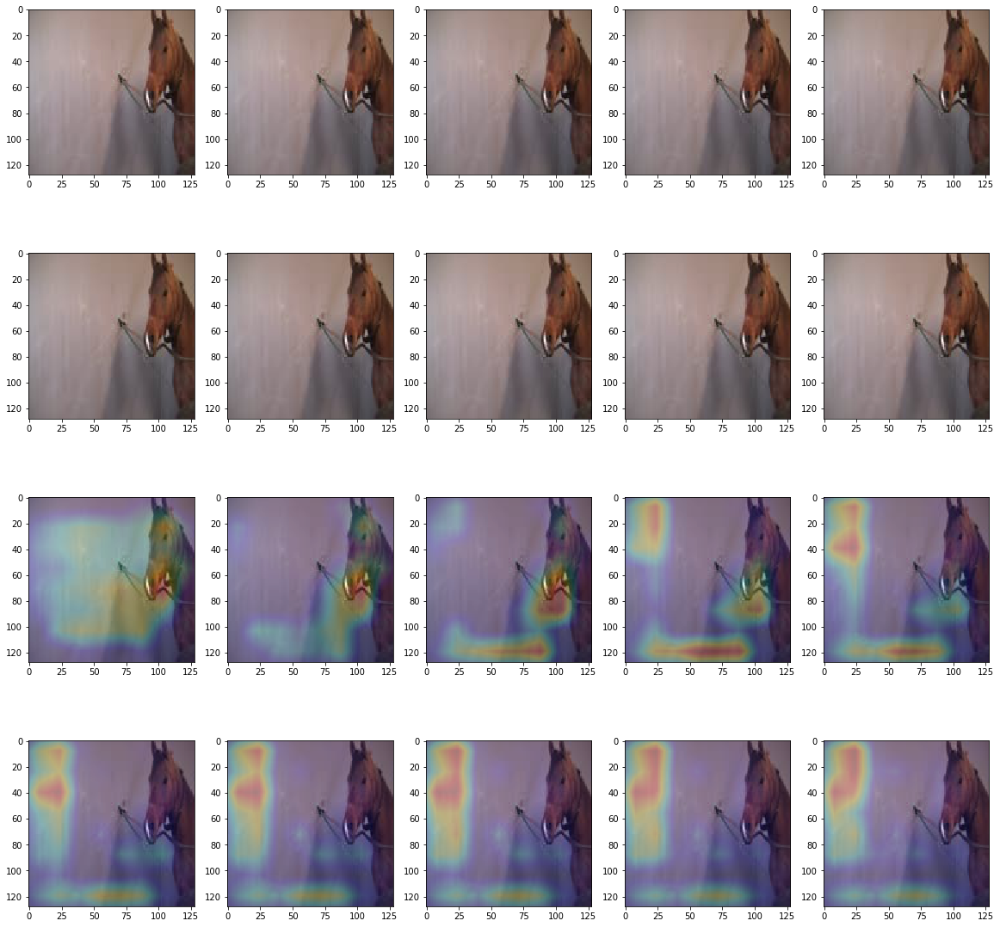

[ 0.64404505  0.35445192]
[ 0.83981121  0.10014988]
[ 0.96906227  0.01128395]
[ 0.99418432  0.00160414]
[  9.98663783e-01   4.52339969e-04]
[  9.99296308e-01   2.14713014e-04]
[  9.99371707e-01   1.89219703e-04]
[  9.99336898e-01   2.13200576e-04]
[  9.99313831e-01   2.73538288e-04]
[  9.99220133e-01   4.43758094e-04]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [83]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.66944605  0.32769194]
  [ 0.66515642  0.36557907]
  [ 0.53943586  0.58612013]
  [ 0.33805996  0.79737234]
  [ 0.20410544  0.89303339]
  [ 0.14530368  0.94853723]
  [ 0.12193459  0.97470278]
  [ 0.11744729  0.98098135]
  [ 0.10668821  0.98615438]
  [ 0.07554537  0.98525745]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


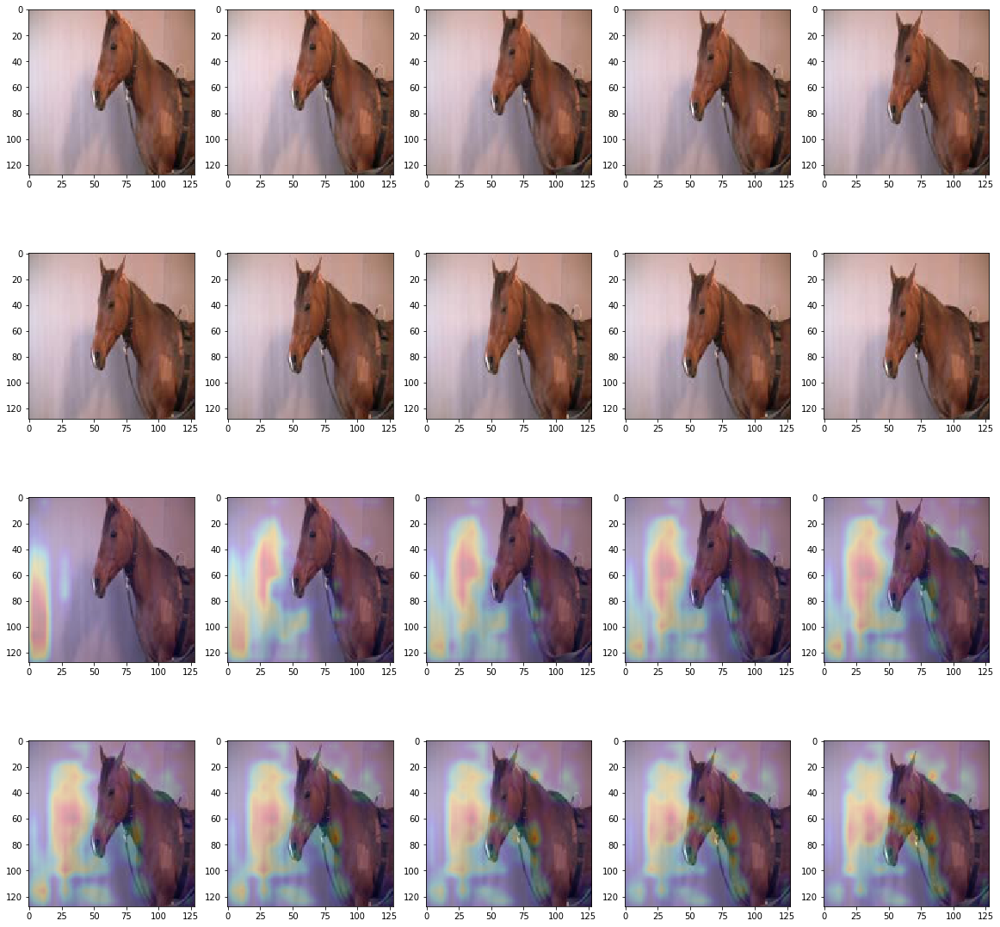

[ 0.66944605  0.32769194]
[ 0.66515642  0.36557907]
[ 0.53943586  0.58612013]
[ 0.33805996  0.79737234]
[ 0.20410544  0.89303339]
[ 0.14530368  0.94853723]
[ 0.12193459  0.97470278]
[ 0.11744729  0.98098135]
[ 0.10668821  0.98615438]
[ 0.07554537  0.98525745]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [47]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[  5.38892090e-01   4.19611752e-01]
  [  1.03261478e-01   8.56204331e-01]
  [  1.75446412e-03   9.96169746e-01]
  [  1.23304242e-04   9.99805152e-01]
  [  6.08952178e-05   9.99962687e-01]
  [  6.49810609e-05   9.99982119e-01]
  [  8.20346249e-05   9.99980927e-01]
  [  2.07742400e-04   9.99972463e-01]
  [  6.43460487e-04   9.99953508e-01]
  [  2.44083581e-03   9.99920964e-01]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


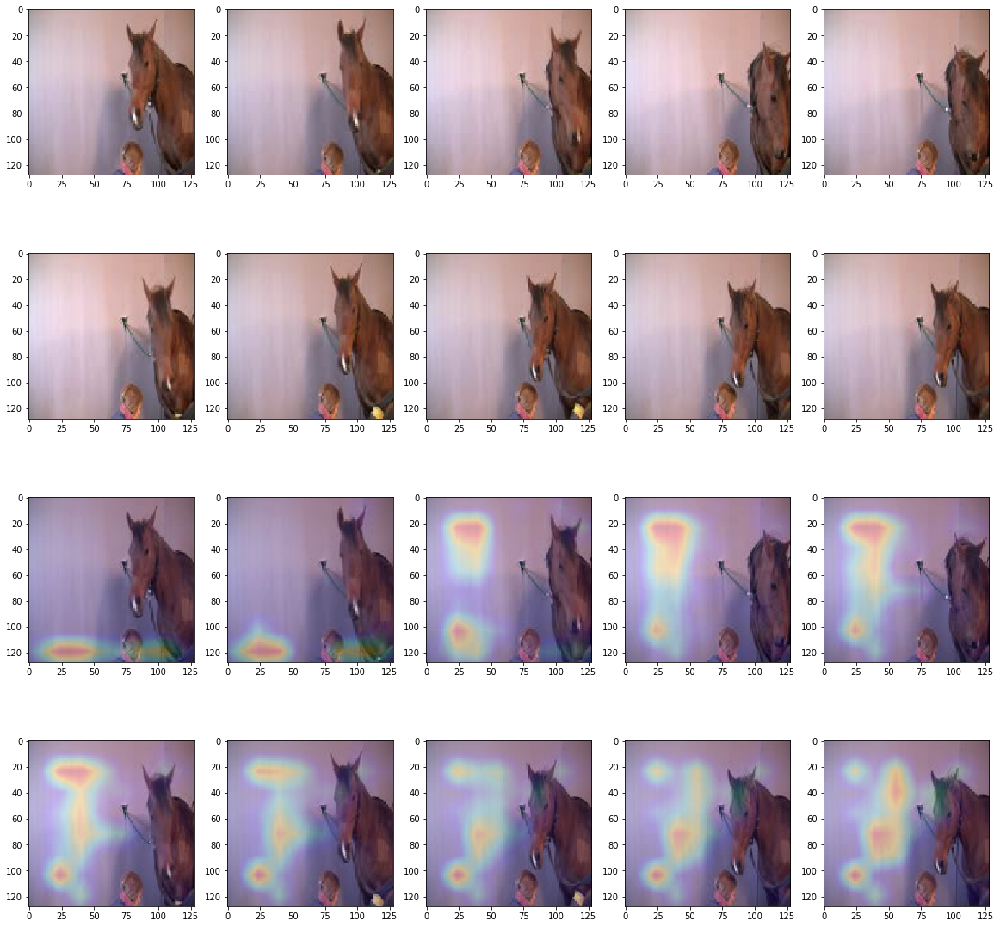

[ 0.53889209  0.41961175]
[ 0.10326148  0.85620433]
[ 0.00175446  0.99616975]
[  1.23304242e-04   9.99805152e-01]
[  6.08952178e-05   9.99962687e-01]
[  6.49810609e-05   9.99982119e-01]
[  8.20346249e-05   9.99980927e-01]
[  2.07742400e-04   9.99972463e-01]
[  6.43460487e-04   9.99953508e-01]
[ 0.00244084  0.99992096]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [84]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.65483499  0.37142077]
  [ 0.64193696  0.47177985]
  [ 0.47652748  0.64961517]
  [ 0.32482171  0.76155829]
  [ 0.2946727   0.80685937]
  [ 0.28778523  0.79233789]
  [ 0.31785166  0.75034475]
  [ 0.34791458  0.70025378]
  [ 0.39334959  0.62228358]
  [ 0.43611357  0.57538027]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


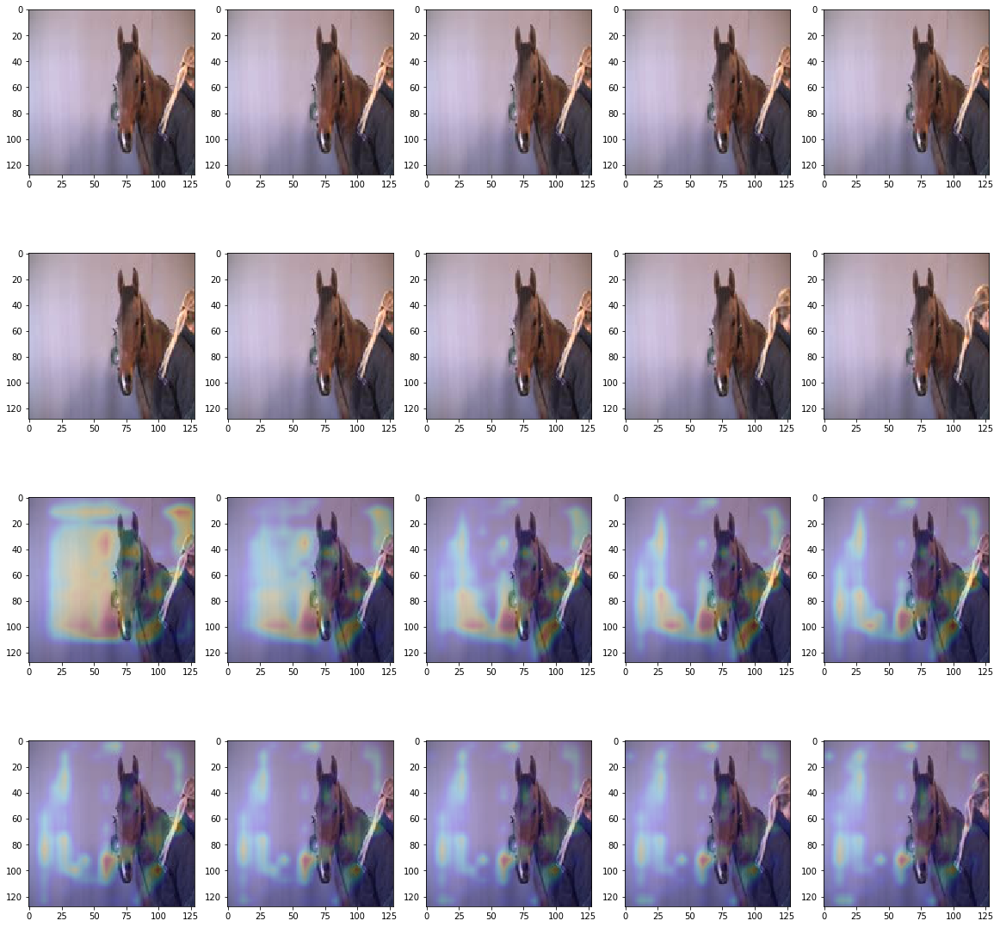

[ 0.65483499  0.37142077]
[ 0.64193696  0.47177985]
[ 0.47652748  0.64961517]
[ 0.32482171  0.76155829]
[ 0.2946727   0.80685937]
[ 0.28778523  0.79233789]
[ 0.31785166  0.75034475]
[ 0.34791458  0.70025378]
[ 0.39334959  0.62228358]
[ 0.43611357  0.57538027]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [49]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.66336095  0.31172463]
  [ 0.81948256  0.16399653]
  [ 0.82379586  0.09327549]
  [ 0.80233032  0.05500501]
  [ 0.77198809  0.03417834]
  [ 0.81542438  0.02932312]
  [ 0.86576182  0.02584172]
  [ 0.90817183  0.02427372]
  [ 0.92983997  0.01856941]
  [ 0.94398421  0.01713284]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


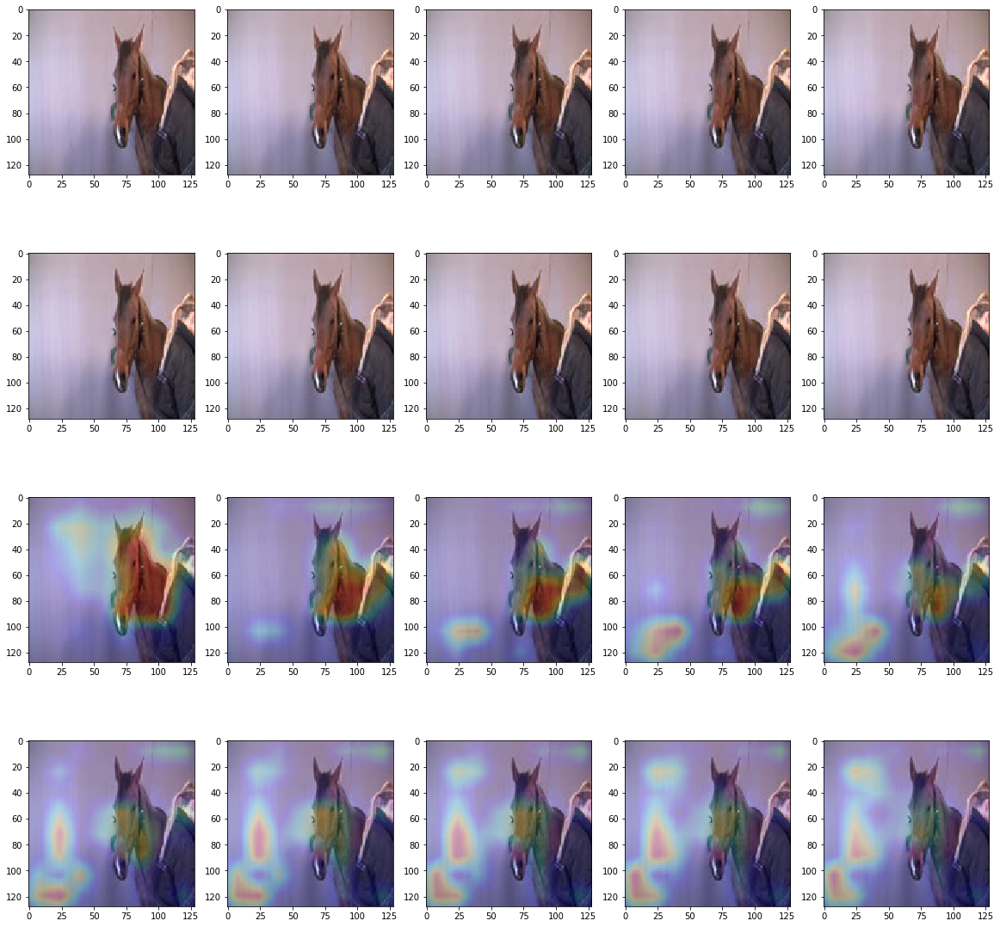

[ 0.66336095  0.31172463]
[ 0.81948256  0.16399653]
[ 0.82379586  0.09327549]
[ 0.80233032  0.05500501]
[ 0.77198809  0.03417834]
[ 0.81542438  0.02932312]
[ 0.86576182  0.02584172]
[ 0.90817183  0.02427372]
[ 0.92983997  0.01856941]
[ 0.94398421  0.01713284]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [85]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.748456    0.23990701]
  [ 0.8938145   0.08846889]
  [ 0.96540856  0.03552641]
  [ 0.98821568  0.02050382]
  [ 0.99339116  0.01722125]
  [ 0.99565315  0.0179803 ]
  [ 0.99725682  0.01967107]
  [ 0.99793291  0.02325318]
  [ 0.99812287  0.0263826 ]
  [ 0.99817014  0.03004798]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


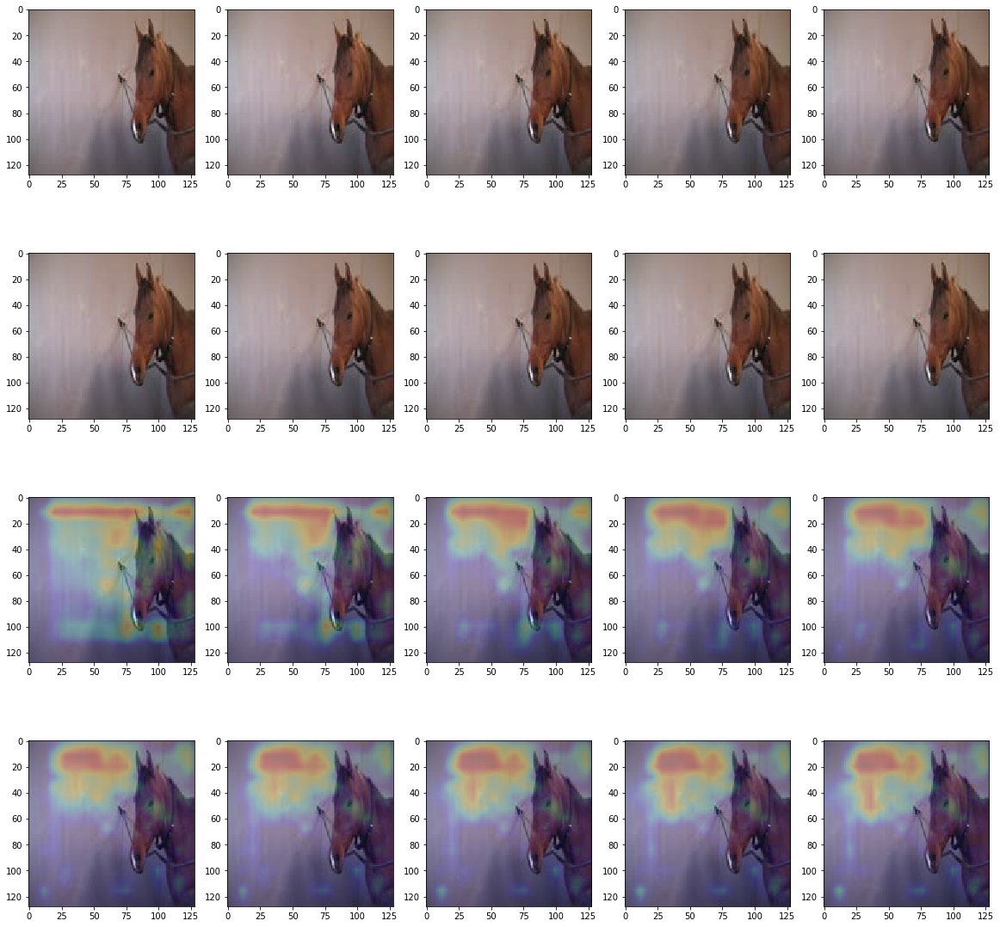

[ 0.748456    0.23990701]
[ 0.8938145   0.08846889]
[ 0.96540856  0.03552641]
[ 0.98821568  0.02050382]
[ 0.99339116  0.01722125]
[ 0.99565315  0.0179803 ]
[ 0.99725682  0.01967107]
[ 0.99793291  0.02325318]
[ 0.99812287  0.0263826 ]
[ 0.99817014  0.03004798]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [51]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[  5.57586968e-01   4.35261726e-01]
  [  3.12859982e-01   6.24898970e-01]
  [  2.12265607e-02   9.29274678e-01]
  [  1.38715468e-03   9.87944603e-01]
  [  3.29791597e-04   9.97030497e-01]
  [  2.58089567e-04   9.98880804e-01]
  [  4.46431106e-04   9.99305725e-01]
  [  1.22020650e-03   9.99282062e-01]
  [  5.55836875e-03   9.99029756e-01]
  [  2.13799439e-02   9.98399556e-01]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


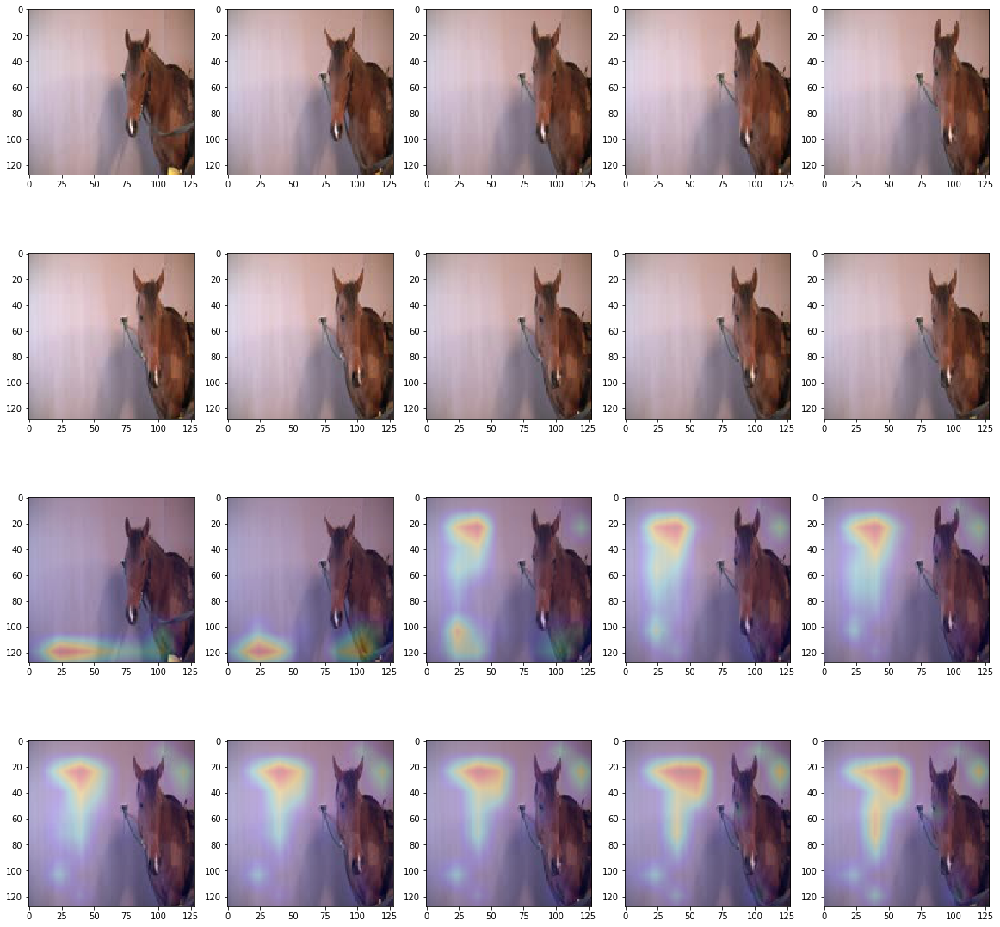

[ 0.55758697  0.43526173]
[ 0.31285998  0.62489897]
[ 0.02122656  0.92927468]
[ 0.00138715  0.9879446 ]
[  3.29791597e-04   9.97030497e-01]
[  2.58089567e-04   9.98880804e-01]
[  4.46431106e-04   9.99305725e-01]
[ 0.00122021  0.99928206]
[ 0.00555837  0.99902976]
[ 0.02137994  0.99839956]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [86]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.69773936  0.31832105]
  [ 0.78504157  0.30174196]
  [ 0.77426559  0.37501726]
  [ 0.69438154  0.46012032]
  [ 0.60587496  0.48149666]
  [ 0.50445169  0.47230697]
  [ 0.43976933  0.44292846]
  [ 0.40296888  0.41159609]
  [ 0.37957945  0.43579331]
  [ 0.33838141  0.47029063]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


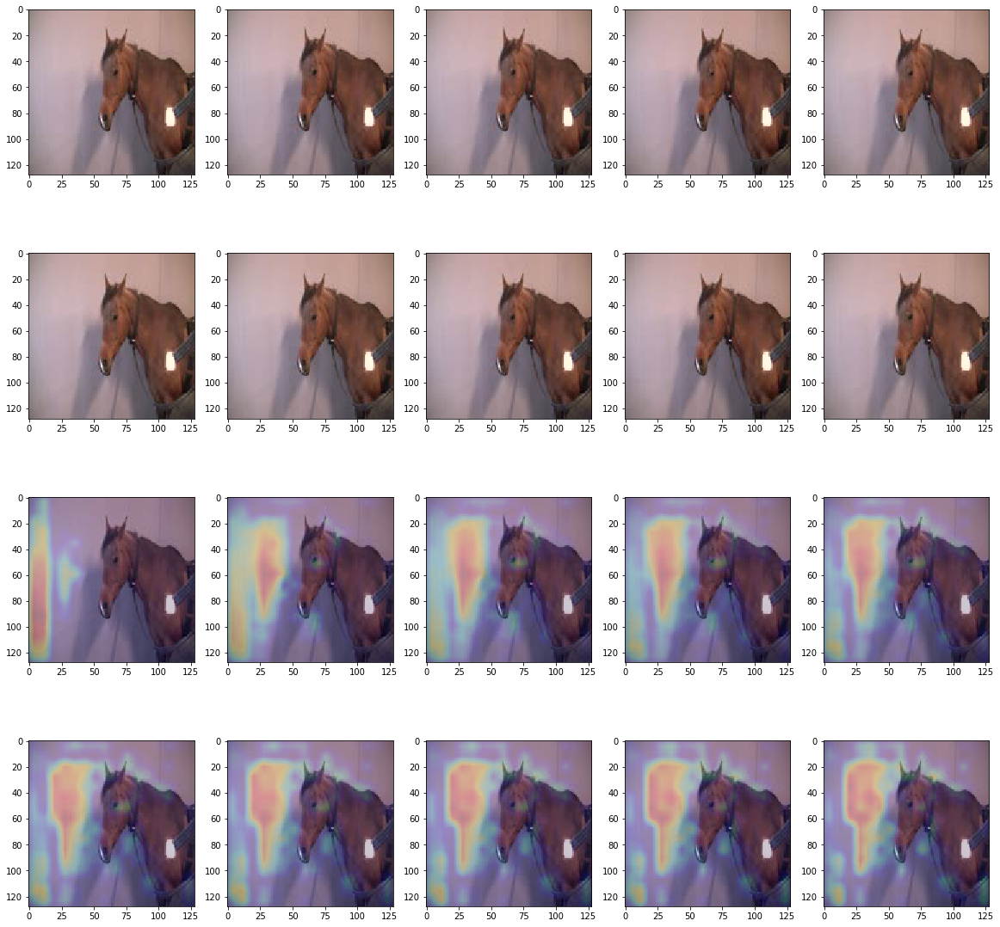

[ 0.69773936  0.31832105]
[ 0.78504157  0.30174196]
[ 0.77426559  0.37501726]
[ 0.69438154  0.46012032]
[ 0.60587496  0.48149666]
[ 0.50445169  0.47230697]
[ 0.43976933  0.44292846]
[ 0.40296888  0.41159609]
[ 0.37957945  0.43579331]
[ 0.33838141  0.47029063]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [53]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.56679195  0.4852742 ]
  [ 0.3434824   0.73615897]
  [ 0.08546131  0.90126133]
  [ 0.03206889  0.94374514]
  [ 0.01578029  0.96137828]
  [ 0.0091651   0.97313416]
  [ 0.00661183  0.97795689]
  [ 0.00701356  0.98053151]
  [ 0.00934512  0.98372805]
  [ 0.01076162  0.98688811]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


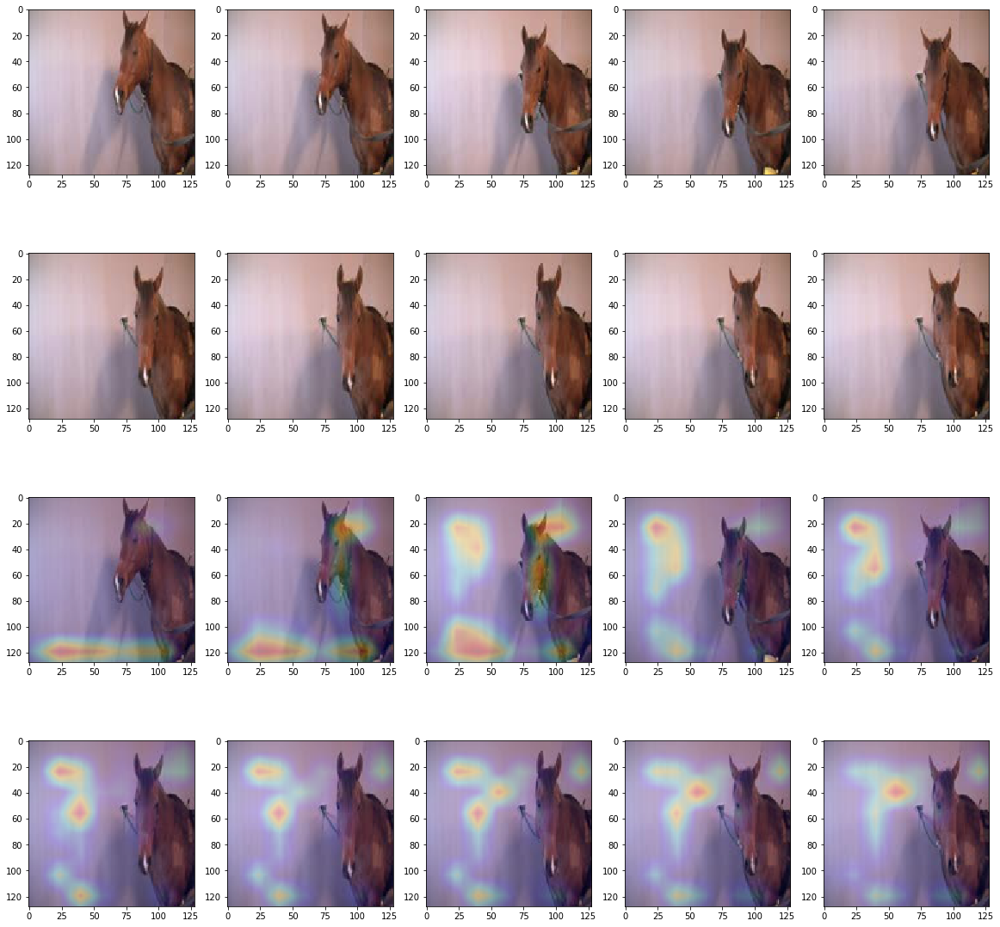

[ 0.56679195  0.4852742 ]
[ 0.3434824   0.73615897]
[ 0.08546131  0.90126133]
[ 0.03206889  0.94374514]
[ 0.01578029  0.96137828]
[ 0.0091651   0.97313416]
[ 0.00661183  0.97795689]
[ 0.00701356  0.98053151]
[ 0.00934512  0.98372805]
[ 0.01076162  0.98688811]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [87]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.54949623  0.42695826]
  [ 0.33387515  0.56900501]
  [ 0.12984604  0.77012378]
  [ 0.05151249  0.87691981]
  [ 0.02229491  0.91966021]
  [ 0.01490743  0.93625814]
  [ 0.01067917  0.94202536]
  [ 0.00963215  0.935646  ]
  [ 0.00986121  0.92523754]
  [ 0.01027345  0.91586876]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


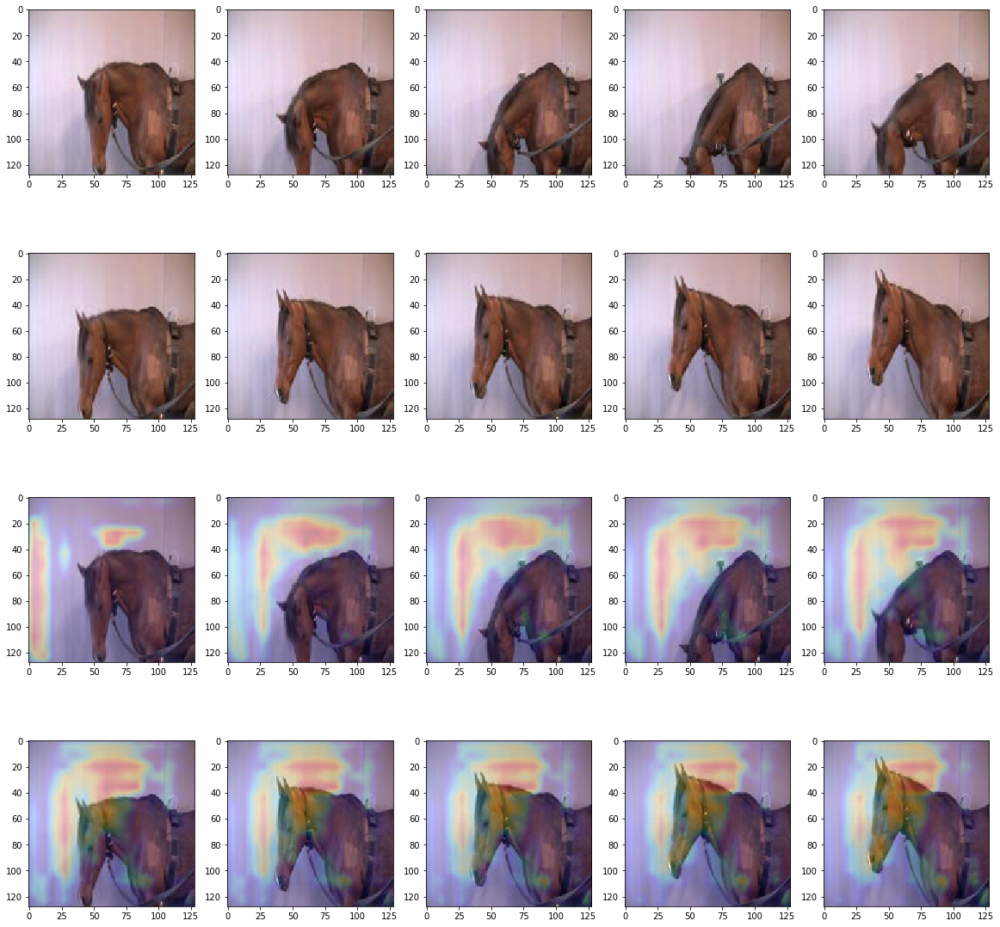

[ 0.54949623  0.42695826]
[ 0.33387515  0.56900501]
[ 0.12984604  0.77012378]
[ 0.05151249  0.87691981]
[ 0.02229491  0.91966021]
[ 0.01490743  0.93625814]
[ 0.01067917  0.94202536]
[ 0.00963215  0.935646  ]
[ 0.00986121  0.92523754]
[ 0.01027345  0.91586876]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [55]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.64314085  0.37084195]
  [ 0.52880168  0.46593443]
  [ 0.14367335  0.70410436]
  [ 0.02941713  0.84135509]
  [ 0.00904058  0.90911275]
  [ 0.0037568   0.94944125]
  [ 0.00205287  0.97345179]
  [ 0.0017485   0.98303717]
  [ 0.00203278  0.98832381]
  [ 0.00350586  0.98803127]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


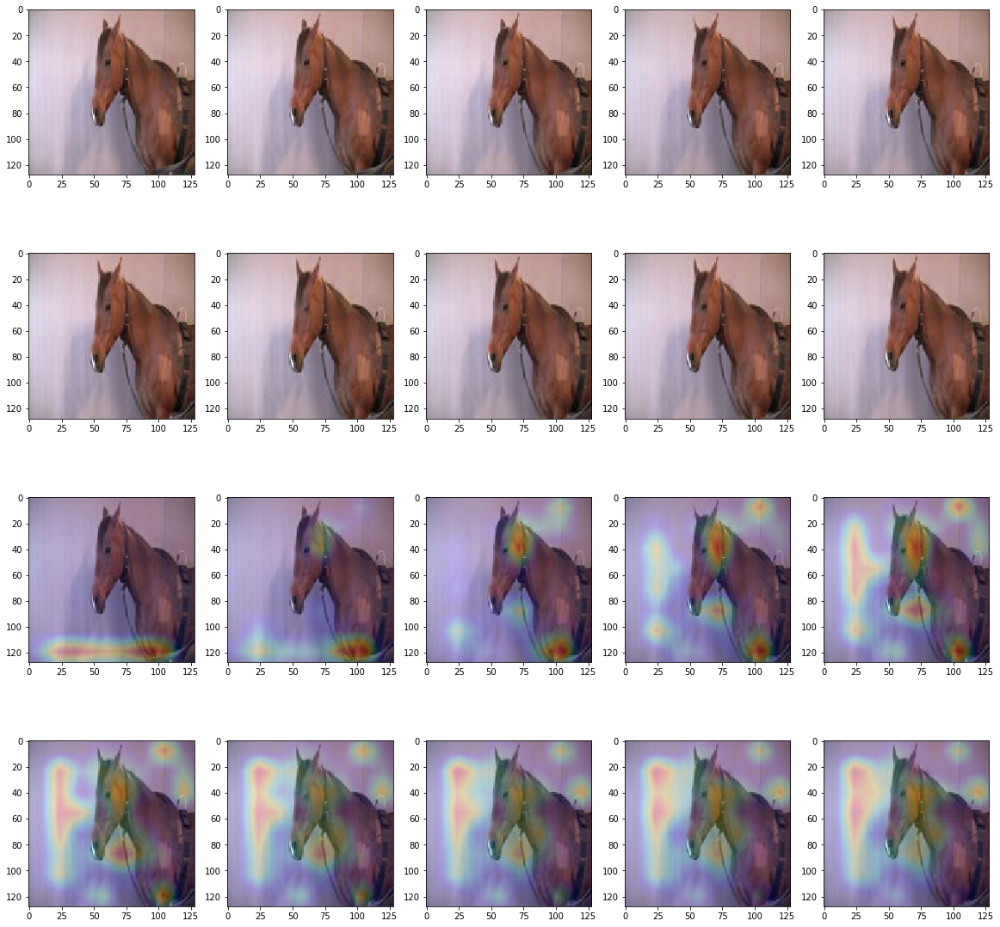

[ 0.64314085  0.37084195]
[ 0.52880168  0.46593443]
[ 0.14367335  0.70410436]
[ 0.02941713  0.84135509]
[ 0.00904058  0.90911275]
[ 0.0037568   0.94944125]
[ 0.00205287  0.97345179]
[ 0.0017485   0.98303717]
[ 0.00203278  0.98832381]
[ 0.00350586  0.98803127]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [88]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.69277233  0.21959534]
  [ 0.87536895  0.05312641]
  [ 0.95684296  0.0180253 ]
  [ 0.98130304  0.01212385]
  [ 0.98726559  0.01311154]
  [ 0.9890371   0.01437544]
  [ 0.9915154   0.01993081]
  [ 0.99261099  0.02508027]
  [ 0.9930951   0.02847536]
  [ 0.99364728  0.03208838]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


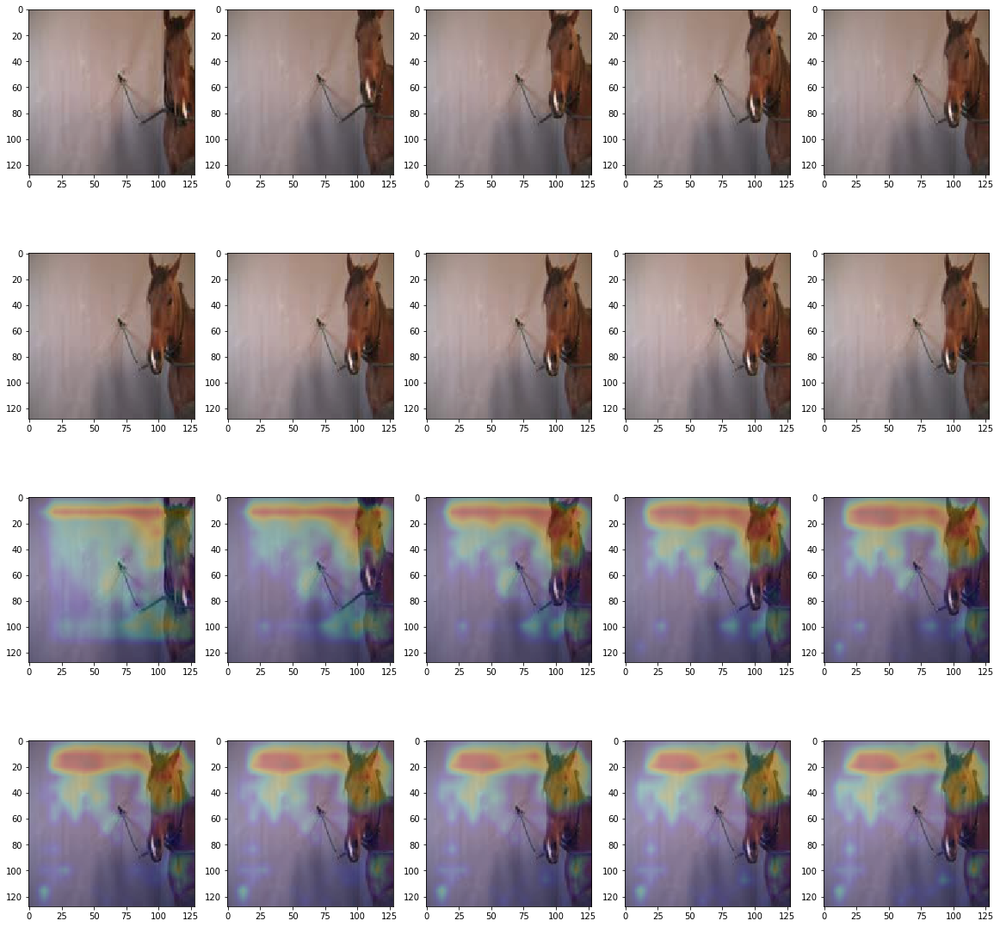

[ 0.69277233  0.21959534]
[ 0.87536895  0.05312641]
[ 0.95684296  0.0180253 ]
[ 0.98130304  0.01212385]
[ 0.98726559  0.01311154]
[ 0.9890371   0.01437544]
[ 0.9915154   0.01993081]
[ 0.99261099  0.02508027]
[ 0.9930951   0.02847536]
[ 0.99364728  0.03208838]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [57]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.64079618  0.2931183 ]
  [ 0.62622893  0.24716616]
  [ 0.59541023  0.23918548]
  [ 0.64174712  0.20494445]
  [ 0.72190052  0.14171232]
  [ 0.77219319  0.1003359 ]
  [ 0.78903449  0.06957861]
  [ 0.79568124  0.05656668]
  [ 0.80036485  0.04347507]
  [ 0.81303877  0.0370496 ]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


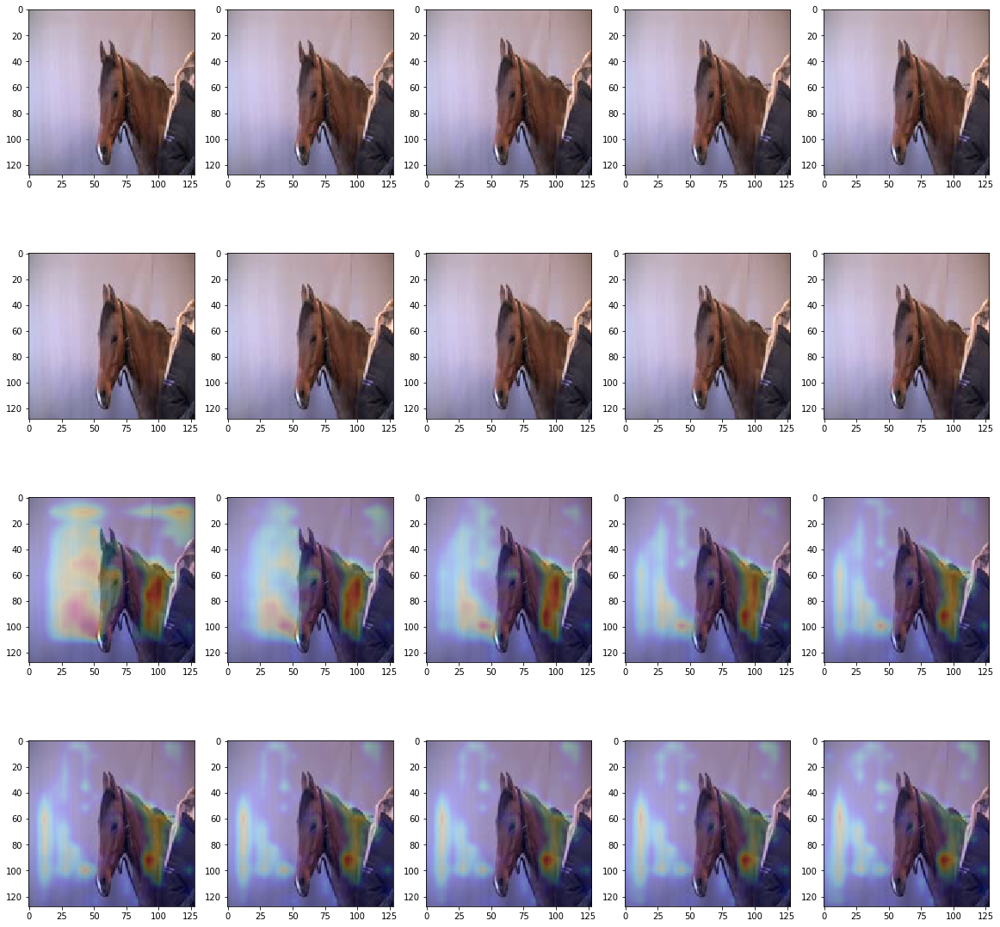

[ 0.64079618  0.2931183 ]
[ 0.62622893  0.24716616]
[ 0.59541023  0.23918548]
[ 0.64174712  0.20494445]
[ 0.72190052  0.14171232]
[ 0.77219319  0.1003359 ]
[ 0.78903449  0.06957861]
[ 0.79568124  0.05656668]
[ 0.80036485  0.04347507]
[ 0.81303877  0.0370496 ]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [58]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.75183743  0.29931256]
  [ 0.83530718  0.28201723]
  [ 0.8187958   0.38197446]
  [ 0.77053732  0.5286774 ]
  [ 0.7407853   0.60599703]
  [ 0.71464288  0.60063726]
  [ 0.69035733  0.54490787]
  [ 0.64986658  0.51115811]
  [ 0.59944642  0.48826379]
  [ 0.55306172  0.42448267]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


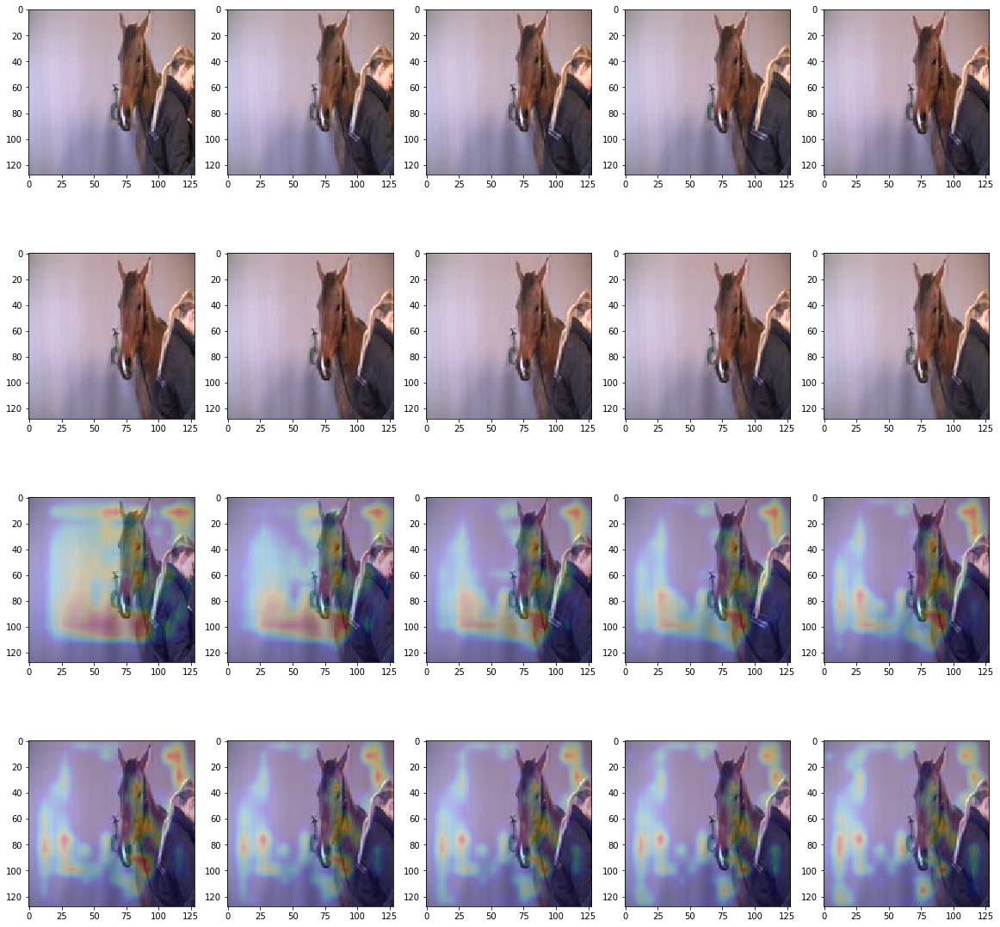

[ 0.75183743  0.29931256]
[ 0.83530718  0.28201723]
[ 0.8187958   0.38197446]
[ 0.77053732  0.5286774 ]
[ 0.7407853   0.60599703]
[ 0.71464288  0.60063726]
[ 0.69035733  0.54490787]
[ 0.64986658  0.51115811]
[ 0.59944642  0.48826379]
[ 0.55306172  0.42448267]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [59]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.75221944  0.20503162]
  [ 0.90671921  0.06765591]
  [ 0.965433    0.02615164]
  [ 0.98717749  0.01171971]
  [ 0.99460512  0.00807155]
  [ 0.99782348  0.00881132]
  [ 0.99893218  0.01119294]
  [ 0.99924743  0.0127599 ]
  [ 0.99933726  0.0129812 ]
  [ 0.99924588  0.01420887]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


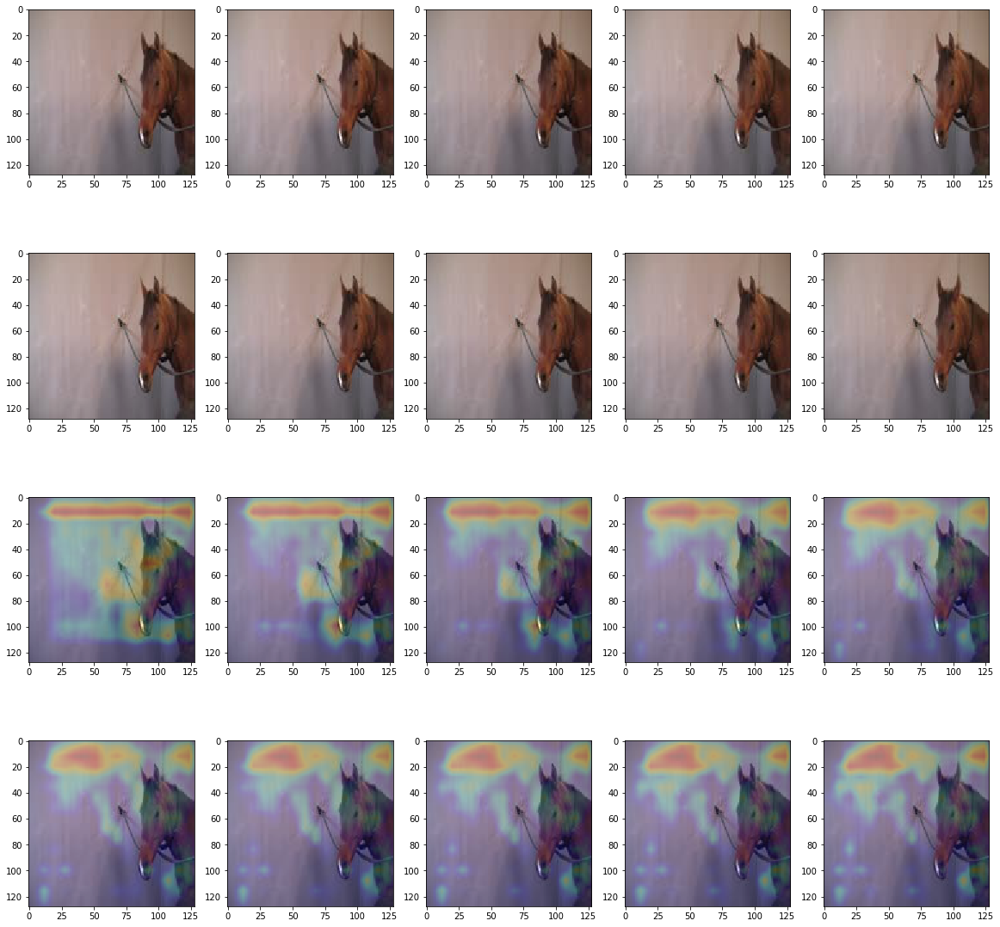

[ 0.75221944  0.20503162]
[ 0.90671921  0.06765591]
[ 0.965433    0.02615164]
[ 0.98717749  0.01171971]
[ 0.99460512  0.00807155]
[ 0.99782348  0.00881132]
[ 0.99893218  0.01119294]
[ 0.99924743  0.0127599 ]
[ 0.99933726  0.0129812 ]
[ 0.99924588  0.01420887]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [60]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.76512665  0.18444668]
  [ 0.91184449  0.04737021]
  [ 0.96280211  0.0176085 ]
  [ 0.98162526  0.01039909]
  [ 0.9894169   0.00835182]
  [ 0.99330312  0.00727501]
  [ 0.99535948  0.00693093]
  [ 0.99591786  0.0068228 ]
  [ 0.99596977  0.00696839]
  [ 0.99587858  0.00728425]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


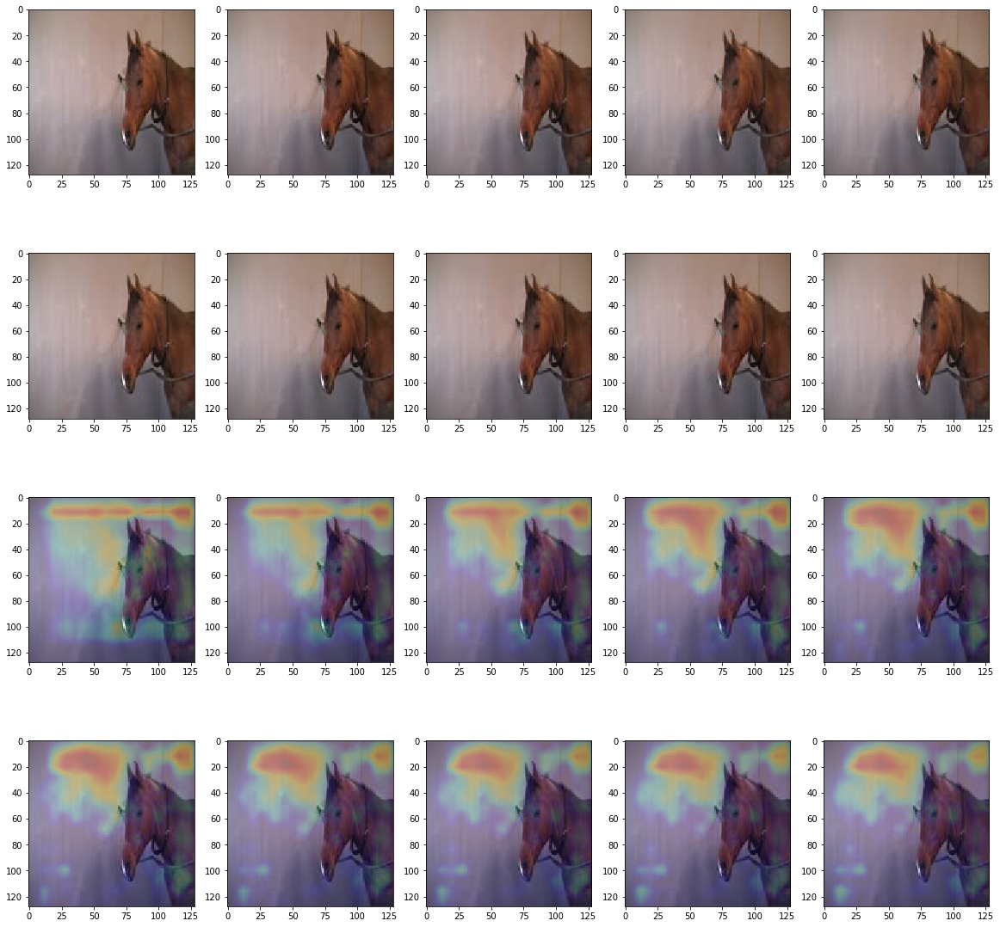

[ 0.76512665  0.18444668]
[ 0.91184449  0.04737021]
[ 0.96280211  0.0176085 ]
[ 0.98162526  0.01039909]
[ 0.9894169   0.00835182]
[ 0.99330312  0.00727501]
[ 0.99535948  0.00693093]
[ 0.99591786  0.0068228 ]
[ 0.99596977  0.00696839]
[ 0.99587858  0.00728425]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [61]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.66655725  0.355048  ]
  [ 0.66837448  0.36734205]
  [ 0.50529659  0.47688589]
  [ 0.2497429   0.58644652]
  [ 0.14631777  0.63221633]
  [ 0.1030537   0.61891747]
  [ 0.07838488  0.59001541]
  [ 0.07622929  0.57576334]
  [ 0.0895299   0.54625821]
  [ 0.10297658  0.50398356]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


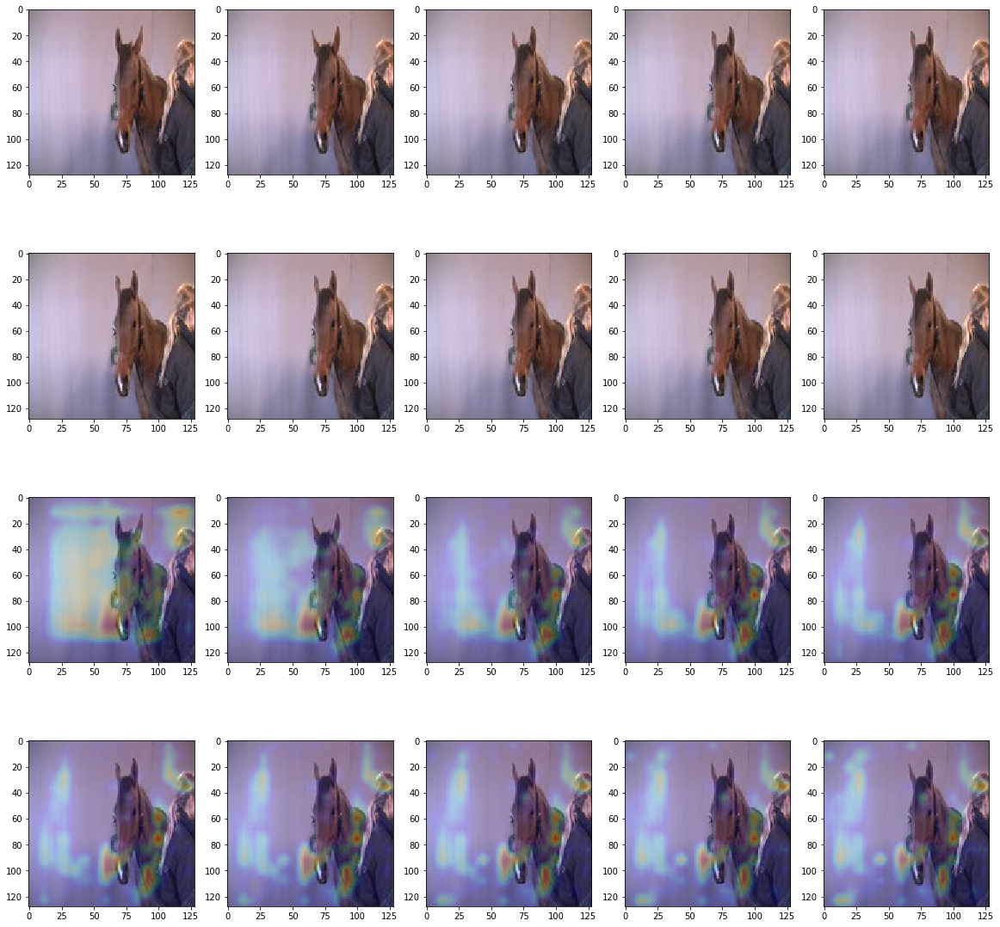

[ 0.66655725  0.355048  ]
[ 0.66837448  0.36734205]
[ 0.50529659  0.47688589]
[ 0.2497429   0.58644652]
[ 0.14631777  0.63221633]
[ 0.1030537   0.61891747]
[ 0.07838488  0.59001541]
[ 0.07622929  0.57576334]
[ 0.0895299   0.54625821]
[ 0.10297658  0.50398356]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [62]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.63664705  0.37629956]
  [ 0.61291933  0.52988905]
  [ 0.50776559  0.76818198]
  [ 0.32795823  0.88599932]
  [ 0.21256791  0.92648047]
  [ 0.1583603   0.92662966]
  [ 0.12306736  0.9086386 ]
  [ 0.10099702  0.88040686]
  [ 0.08797956  0.85365045]
  [ 0.08915301  0.83415908]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


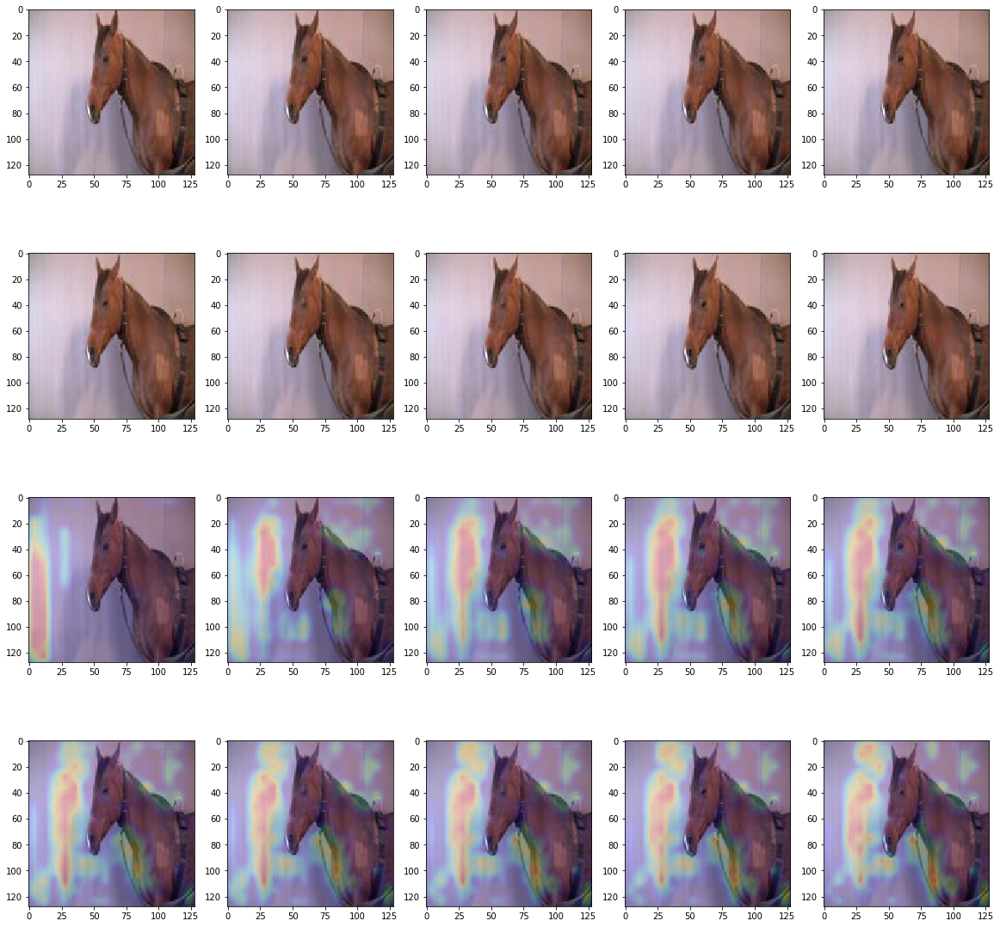

[ 0.63664705  0.37629956]
[ 0.61291933  0.52988905]
[ 0.50776559  0.76818198]
[ 0.32795823  0.88599932]
[ 0.21256791  0.92648047]
[ 0.1583603   0.92662966]
[ 0.12306736  0.9086386 ]
[ 0.10099702  0.88040686]
[ 0.08797956  0.85365045]
[ 0.08915301  0.83415908]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [63]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.60432208  0.37965983]
  [ 0.57370085  0.47877553]
  [ 0.48586175  0.6383937 ]
  [ 0.3337366   0.75506407]
  [ 0.22156337  0.82676488]
  [ 0.14944772  0.83160543]
  [ 0.12017456  0.80663002]
  [ 0.10048564  0.7792232 ]
  [ 0.09066354  0.7509985 ]
  [ 0.08916838  0.71960932]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


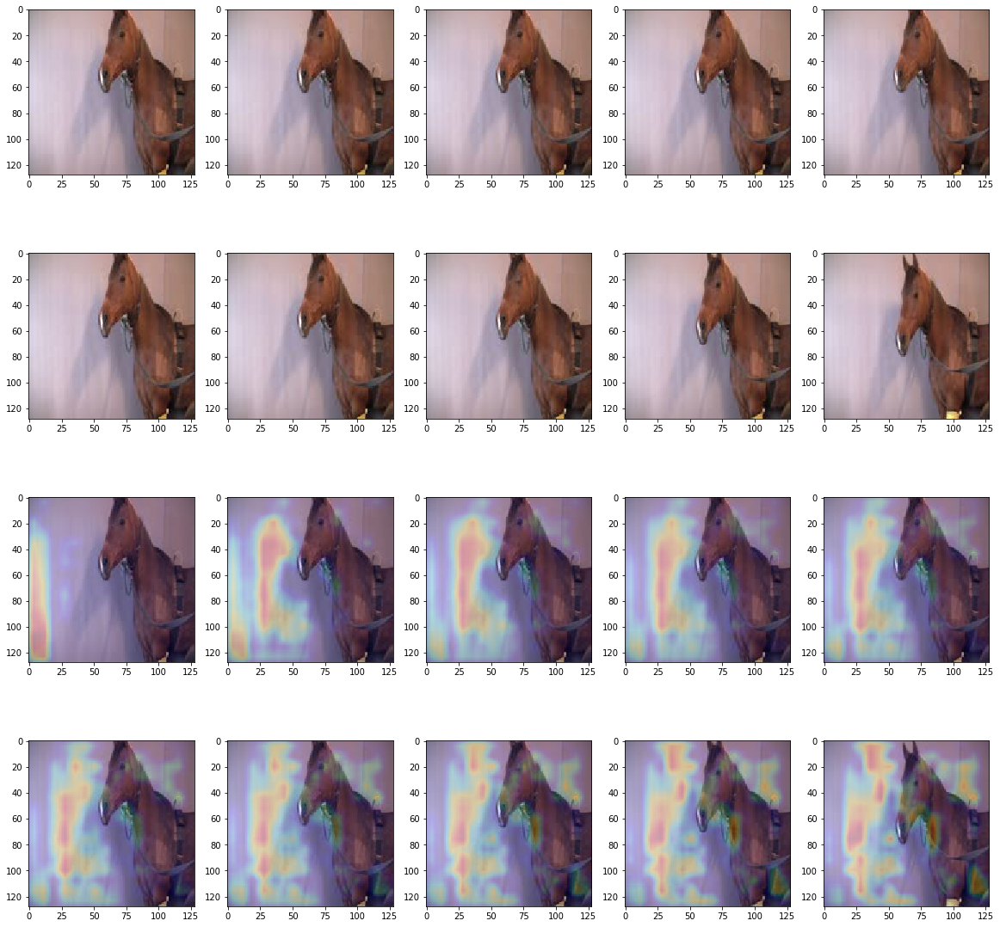

[ 0.60432208  0.37965983]
[ 0.57370085  0.47877553]
[ 0.48586175  0.6383937 ]
[ 0.3337366   0.75506407]
[ 0.22156337  0.82676488]
[ 0.14944772  0.83160543]
[ 0.12017456  0.80663002]
[ 0.10048564  0.7792232 ]
[ 0.09066354  0.7509985 ]
[ 0.08916838  0.71960932]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [64]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.75840813  0.20528859]
  [ 0.9142924   0.05588747]
  [ 0.97606307  0.0152624 ]
  [ 0.99136835  0.00671743]
  [ 0.99518532  0.00432173]
  [ 0.9967829   0.00358993]
  [ 0.99791807  0.00353655]
  [ 0.99857223  0.00309591]
  [ 0.99892288  0.00232873]
  [ 0.99907899  0.00180355]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


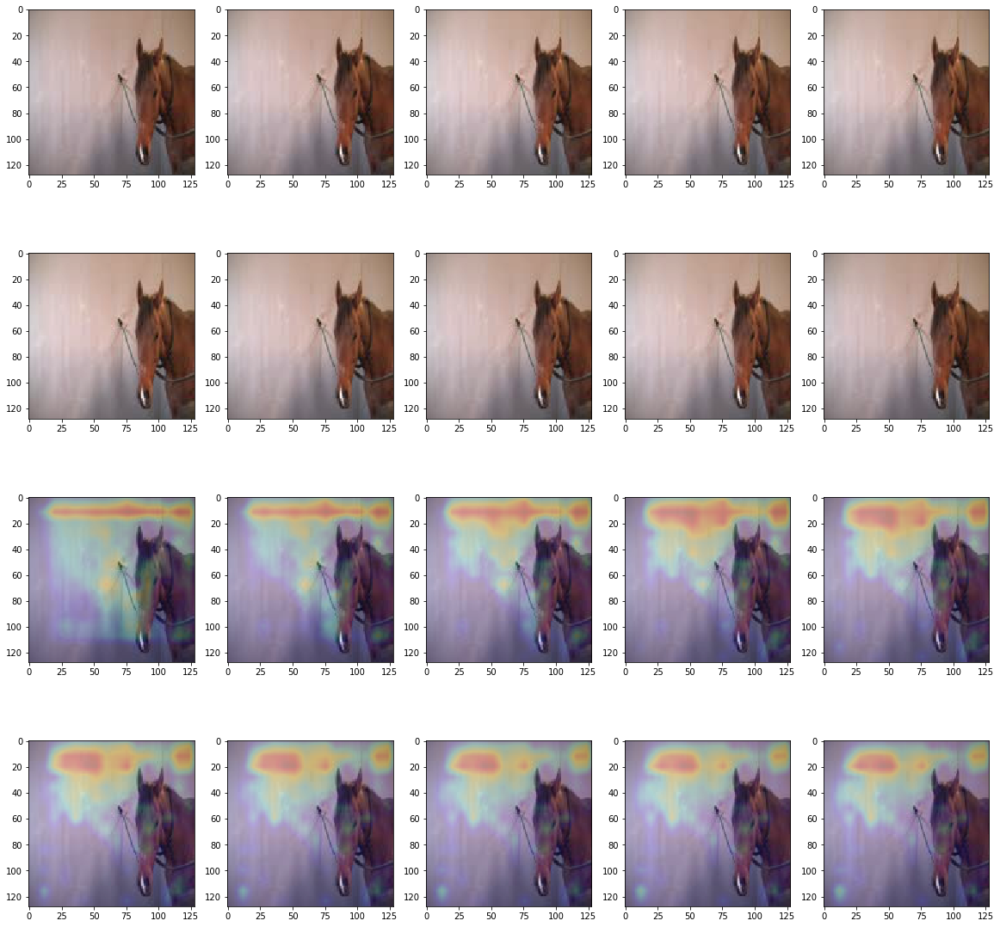

[ 0.75840813  0.20528859]
[ 0.9142924   0.05588747]
[ 0.97606307  0.0152624 ]
[ 0.99136835  0.00671743]
[ 0.99518532  0.00432173]
[ 0.9967829   0.00358993]
[ 0.99791807  0.00353655]
[ 0.99857223  0.00309591]
[ 0.99892288  0.00232873]
[ 0.99907899  0.00180355]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [65]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.70210868  0.27977923]
  [ 0.73619986  0.22911982]
  [ 0.67042822  0.24370724]
  [ 0.64831573  0.2304538 ]
  [ 0.66256851  0.1998156 ]
  [ 0.71927983  0.16169997]
  [ 0.74918252  0.12781528]
  [ 0.76845372  0.1120278 ]
  [ 0.75926644  0.11336834]
  [ 0.75729752  0.13159253]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


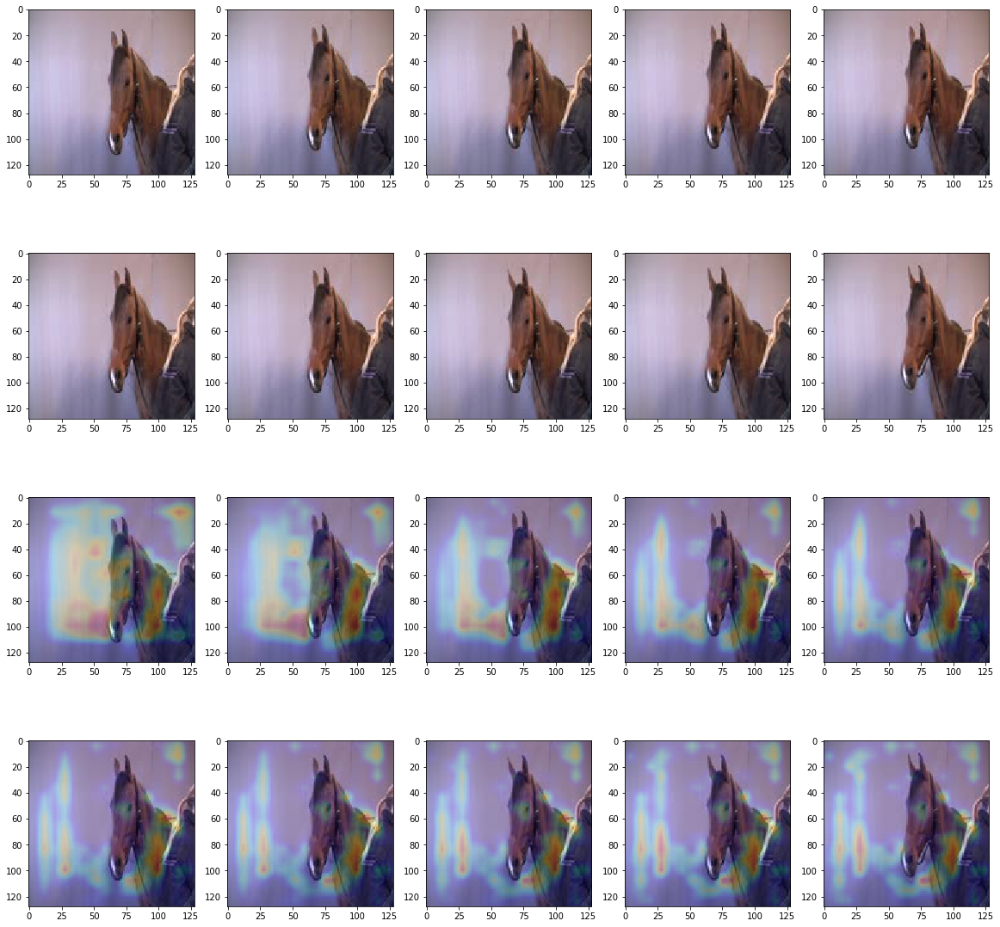

[ 0.70210868  0.27977923]
[ 0.73619986  0.22911982]
[ 0.67042822  0.24370724]
[ 0.64831573  0.2304538 ]
[ 0.66256851  0.1998156 ]
[ 0.71927983  0.16169997]
[ 0.74918252  0.12781528]
[ 0.76845372  0.1120278 ]
[ 0.75926644  0.11336834]
[ 0.75729752  0.13159253]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [66]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.69556797  0.28131872]
  [ 0.69603366  0.26812816]
  [ 0.57702893  0.38570023]
  [ 0.44636554  0.63211679]
  [ 0.31461418  0.83570176]
  [ 0.27068692  0.92040998]
  [ 0.23217832  0.9579224 ]
  [ 0.17301594  0.96479005]
  [ 0.10628294  0.96588737]
  [ 0.06611398  0.96592849]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


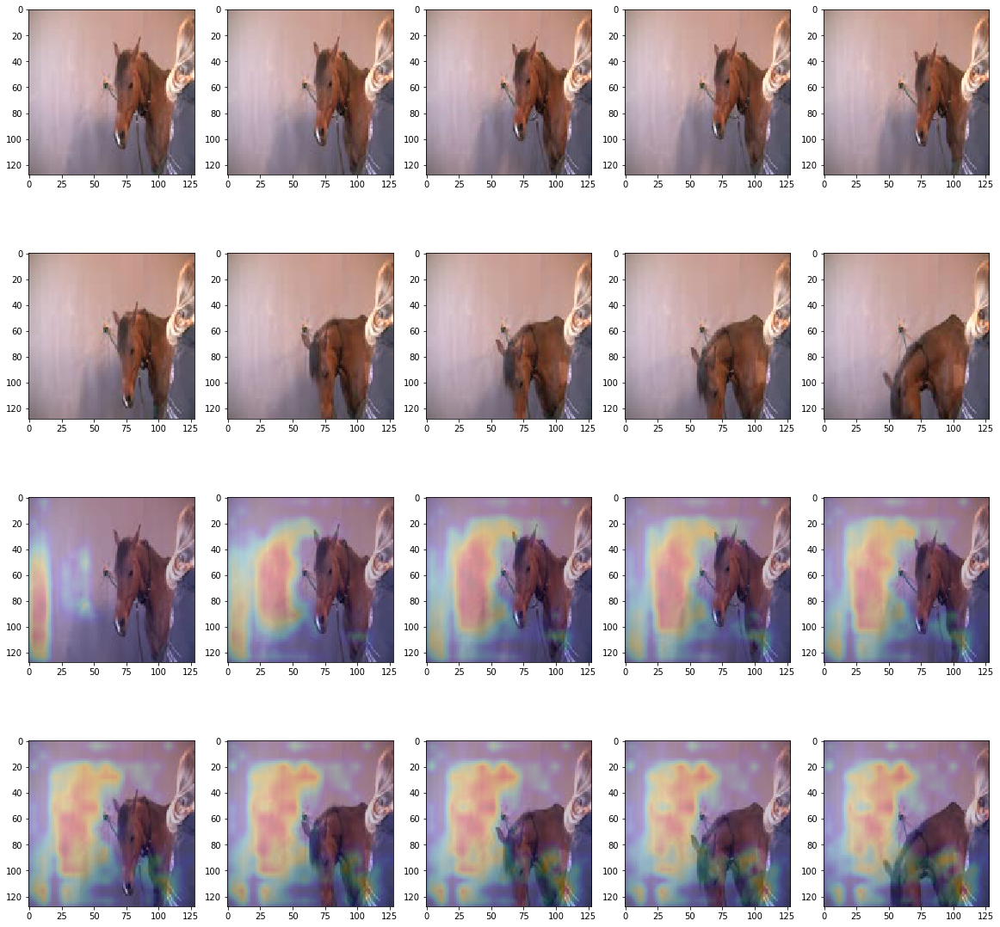

[ 0.69556797  0.28131872]
[ 0.69603366  0.26812816]
[ 0.57702893  0.38570023]
[ 0.44636554  0.63211679]
[ 0.31461418  0.83570176]
[ 0.27068692  0.92040998]
[ 0.23217832  0.9579224 ]
[ 0.17301594  0.96479005]
[ 0.10628294  0.96588737]
[ 0.06611398  0.96592849]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [67]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.74056637  0.21052411]
  [ 0.89891553  0.06196329]
  [ 0.96317381  0.01898012]
  [ 0.98226041  0.00824608]
  [ 0.98801643  0.00561856]
  [ 0.98904687  0.0045876 ]
  [ 0.98988146  0.00515883]
  [ 0.99029541  0.00575878]
  [ 0.99237204  0.00536659]
  [ 0.99296957  0.00504965]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


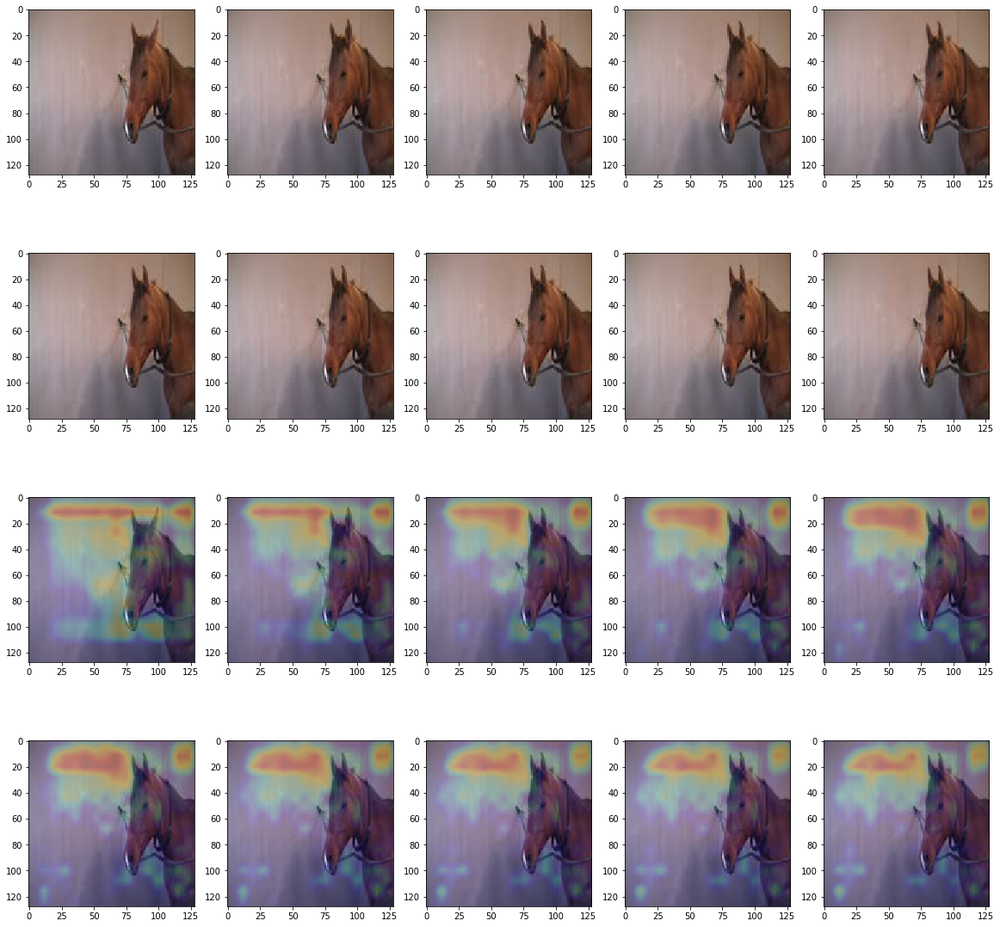

[ 0.74056637  0.21052411]
[ 0.89891553  0.06196329]
[ 0.96317381  0.01898012]
[ 0.98226041  0.00824608]
[ 0.98801643  0.00561856]
[ 0.98904687  0.0045876 ]
[ 0.98988146  0.00515883]
[ 0.99029541  0.00575878]
[ 0.99237204  0.00536659]
[ 0.99296957  0.00504965]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [68]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[  7.70684600e-01   2.34792233e-01]
  [  9.84197676e-01   2.66085714e-02]
  [  9.98764873e-01   2.12083175e-03]
  [  9.99721467e-01   6.45500957e-04]
  [  9.99895334e-01   4.44206904e-04]
  [  9.99917507e-01   4.69840277e-04]
  [  9.99896407e-01   7.48450053e-04]
  [  9.99828339e-01   1.30540272e-03]
  [  9.99730527e-01   2.16012774e-03]
  [  9.99609411e-01   3.25095211e-03]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


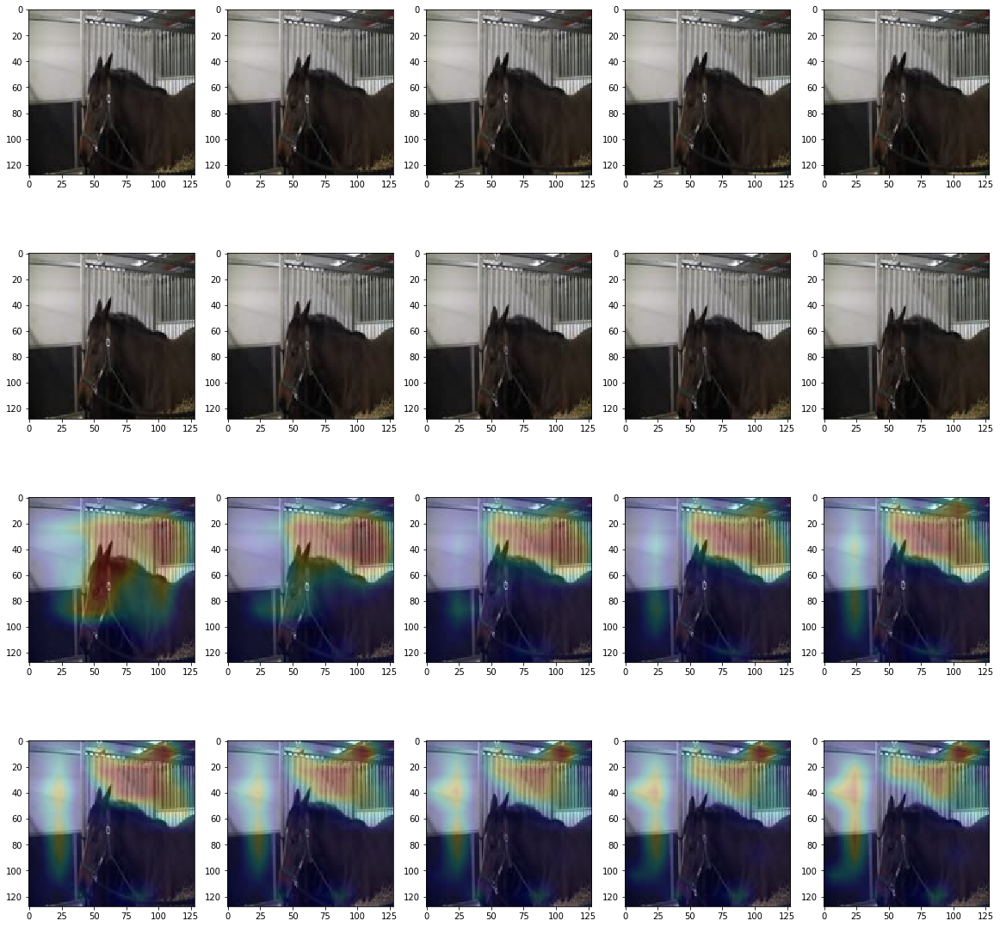

[ 0.7706846   0.23479223]
[ 0.98419768  0.02660857]
[ 0.99876487  0.00212083]
[  9.99721467e-01   6.45500957e-04]
[  9.99895334e-01   4.44206904e-04]
[  9.99917507e-01   4.69840277e-04]
[  9.99896407e-01   7.48450053e-04]
[ 0.99982834  0.0013054 ]
[ 0.99973053  0.00216013]
[ 0.99960941  0.00325095]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [90]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(1)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.39865619  0.5298503 ]
  [ 0.13051847  0.86598754]
  [ 0.05529762  0.97000164]
  [ 0.04444157  0.98476183]
  [ 0.05995915  0.98401469]
  [ 0.08991462  0.97760004]
  [ 0.13042435  0.9746635 ]
  [ 0.16444086  0.97404712]
  [ 0.20218982  0.97467357]
  [ 0.24764588  0.97483999]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


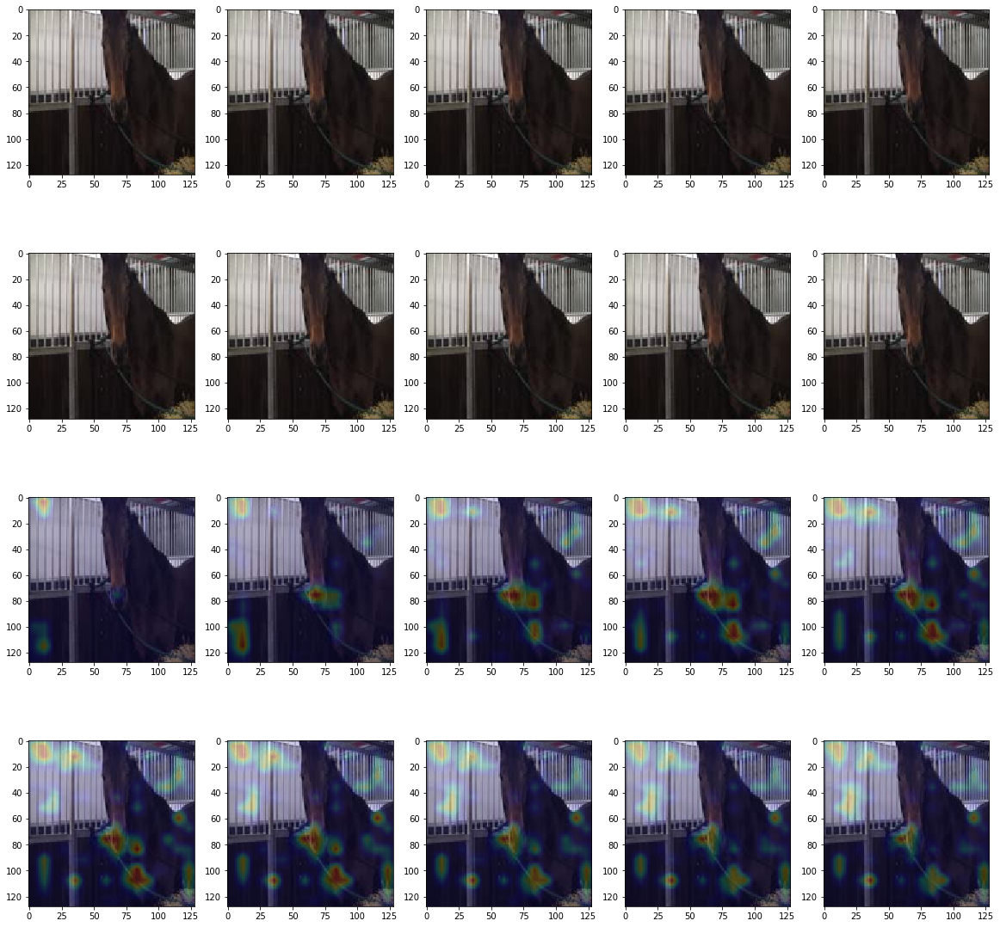

[ 0.39865619  0.5298503 ]
[ 0.13051847  0.86598754]
[ 0.05529762  0.97000164]
[ 0.04444157  0.98476183]
[ 0.05995915  0.98401469]
[ 0.08991462  0.97760004]
[ 0.13042435  0.9746635 ]
[ 0.16444086  0.97404712]
[ 0.20218982  0.97467357]
[ 0.24764588  0.97483999]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [70]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.58798534  0.45423919]
  [ 0.40329447  0.70824265]
  [ 0.15882994  0.92281604]
  [ 0.05154294  0.98027521]
  [ 0.02274344  0.99350995]
  [ 0.0165649   0.99685055]
  [ 0.01283628  0.99773383]
  [ 0.01242363  0.99803084]
  [ 0.01450622  0.99790418]
  [ 0.01758583  0.99732167]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


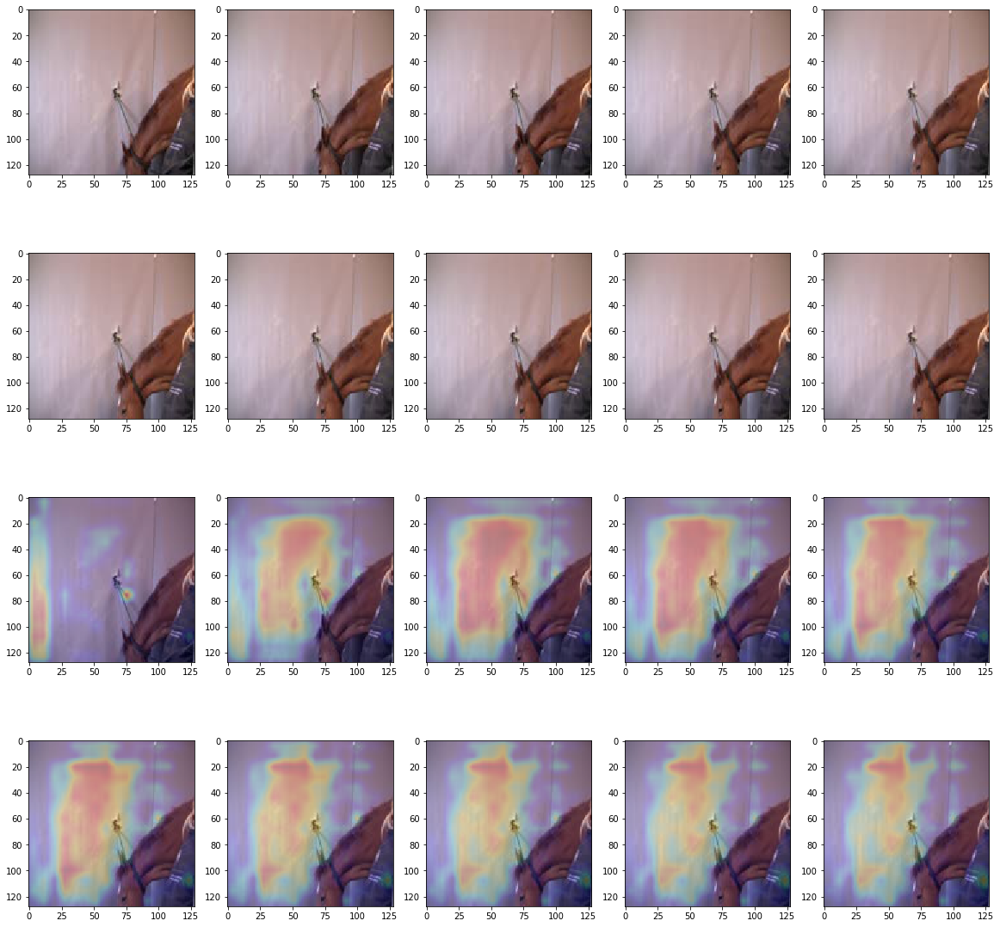

[ 0.58798534  0.45423919]
[ 0.40329447  0.70824265]
[ 0.15882994  0.92281604]
[ 0.05154294  0.98027521]
[ 0.02274344  0.99350995]
[ 0.0165649   0.99685055]
[ 0.01283628  0.99773383]
[ 0.01242363  0.99803084]
[ 0.01450622  0.99790418]
[ 0.01758583  0.99732167]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [71]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(2)
run_on_one_sequence(batch_img, batch_flow)

[[[  6.42351389e-01   3.96506697e-01]
  [  3.26513439e-01   5.95665276e-01]
  [  1.17397476e-02   9.52210426e-01]
  [  1.00335141e-03   9.96427119e-01]
  [  3.86941800e-04   9.99265969e-01]
  [  2.35148604e-04   9.99545276e-01]
  [  1.89624450e-04   9.99557912e-01]
  [  2.19341222e-04   9.99497414e-01]
  [  5.39453409e-04   9.99140620e-01]
  [  1.55913644e-03   9.98287141e-01]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


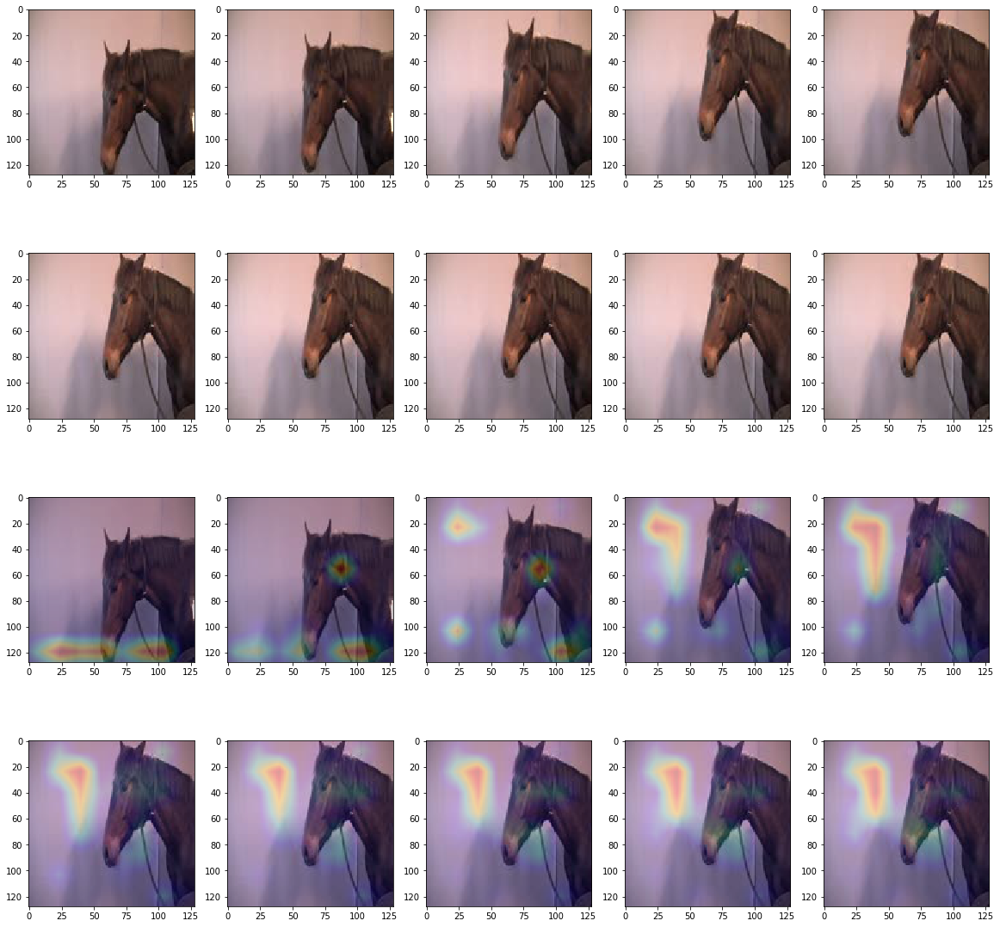

[ 0.64235139  0.3965067 ]
[ 0.32651344  0.59566528]
[ 0.01173975  0.95221043]
[ 0.00100335  0.99642712]
[  3.86941800e-04   9.99265969e-01]
[  2.35148604e-04   9.99545276e-01]
[  1.89624450e-04   9.99557912e-01]
[  2.19341222e-04   9.99497414e-01]
[  5.39453409e-04   9.99140620e-01]
[ 0.00155914  0.99828714]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [89]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(5)
run_on_one_sequence(batch_img, batch_flow)